In [1]:
# Load modules

import xarray as xr
import pandas as pd
import numpy as np
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import zarr
import gcsfs
import xesmf as xe
from scipy.interpolate import griddata
from xmip.preprocessing import rename_cmip6
from matplotlib import gridspec
import time

In [2]:
vert_ds = xr.open_dataarray('/data/keeling/a/mailes2/cesmle_variability_analysis/processed_data/vert_ds.nc')
vert_ds.load()

<xarray.DataArray 'wap' (lat: 88, lon: 179)>
array([[ 9.05317347e-03,  5.35726221e-03,  3.90954921e-03, ...,
         1.37608778e-02,  1.27784014e-02,  1.16651980e-02],
       [ 1.62603296e-02,  1.84076093e-02,  1.68463495e-02, ...,
         2.34749150e-02,  2.32172329e-02,  2.24996507e-02],
       [ 1.72343142e-02,  1.73817184e-02,  1.67526975e-02, ...,
         1.50780585e-02,  1.46754114e-02,  1.46230198e-02],
       ...,
       [-2.22924957e-03, -1.80104235e-03, -1.62051118e-03, ...,
        -1.75005000e-03, -2.10483326e-03, -2.04990618e-03],
       [-6.93217677e-04, -1.27934688e-03, -1.30213355e-03, ...,
        -7.43095938e-04, -8.93206510e-04, -9.83634265e-04],
       [ 4.50923544e-04, -8.85086847e-05,  6.49775393e-05, ...,
        -5.63950336e-04, -4.56162205e-04, -3.77876189e-04]], dtype=float32)
Coordinates:
    plev     float64 5e+04
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357

In [2]:
# Head to google catalog to get some vertical motion data

# Read in data catalog

df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
df.head()

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
0,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,ps,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
1,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
2,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
3,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
4,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,psl,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706


# Surface

### hfls - surface upward latent heat flux

In [26]:
df_hfls_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'hfls' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_hfls_control = df_hfls_control.drop_duplicates('source_id')
df_hfls_control = df_hfls_control[~df_hfls_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_hfls_control = df_hfls_control.drop(index=55602)
#df_hfls_control = df_hfls_control.drop(index=[66920,44318,213494,246463,254048,277247,287686,288653,294932,359892,360724,
#                                             375347,376599,381219,384273,384383])
#df_hfls_control = df_hfls_control.drop(index=67580)
#df_hfls_control = df_hfls_control.drop(index=67682)
#df_hfls_control = df_hfls_control.drop(index=75904)
#df_hfls_control = df_hfls_control.drop(index=206285)
#df_hfls_control = df_hfls_control.drop(index=209092)
#df_hfls_control = df_hfls_control.drop(index=217594)
#df_hfls_control = df_hfls_control.drop(index=236089)
#df_hfls_control = df_hfls_control.drop(index=237861)
print(len(df_hfls_control))
df_hfls_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9283,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,hfls,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18360,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,hfls,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32241,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40387,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44318,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20181212
44787,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55602,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
67580,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67682,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
89845,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,hfls,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [27]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_hfls = []
for zstore in df_hfls_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)    
    ds_hfls_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_hfls = ds_hfls_interp.hfls
    ds_hfls['name'] = name # Creating a new dimension for each ensemble member
    dset_list_hfls.append(ds_hfls)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
BCC-ESM1
<xarray.DataArray 'time' (time: 5412)>
array([cftime.DatetimeNoLeap(1850, 1, 16, 12, 0, 0,

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 8412)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2550, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2550-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2301, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2
<xarray.DataArray 'time' (time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CIESM
<xarray.DataArray 'time' (time

In [28]:
hfls_control = xr.concat(dset_list_hfls, dim='name', coords='minimal', compat='override')
hfls_control.load()

<xarray.DataArray 'hfls' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[ 1.00580297e-01,  6.86186854e-02,  3.62881171e-02, ...,
           2.29935803e-01,  1.97378360e-01,  1.64957663e-01],
         [ 3.53275910e-03,  1.74950700e-02,  3.52396156e-02, ...,
           2.36812238e-01,  1.80600539e-01,  1.24410898e-01],
         [ 5.33161607e-01,  5.01129995e-01,  4.51622553e-01, ...,
           7.23958579e-01,  6.64070785e-01,  6.08542290e-01],
         ...,
         [ 7.07346538e-01,  7.62701923e-01,  8.12389955e-01, ...,
           4.09953965e-01,  4.15736593e-01,  4.32722701e-01],
         [ 4.85109764e-01,  5.54086196e-01,  5.81953526e-01, ...,
           3.44830382e-01,  3.73039931e-01,  4.00880176e-01],
         [ 3.07905348e-01,  3.09701084e-01,  3.09593864e-01, ...,
           3.00216319e-01,  3.02212931e-01,  3.04162671e-01]],

        [[-2.43957536e-01, -2.40427858e-01, -2.36885779e-01, ...,
          -2.58670045e-01, -2.54905216e-01, -2.51194867e-01],
         [-1.85858458e-01, -1.72826123e-01, -1.73399035e-01, ...,
          -2.70151356e-01, -2.53882281e-01, -2.37717009e-01],
         [-2.02165344e-01, -1.96619987e-01, -1.92417122e-01, ...,
          -2.31450648e-01, -2.17919406e-01, -2.04352364e-01],
...
         [-8.27664332e-03, -3.73279554e-02, -8.35974688e-02, ...,
           3.32027192e-02,  4.83377355e-02,  2.42182566e-02],
         [ 1.52142113e-01,  8.32346414e-02,  1.43271674e-02, ...,
           2.93017938e-01,  2.93374339e-01,  2.50662937e-01],
         [ 1.96249019e-01,  1.97700783e-01,  1.99152543e-01, ...,
           1.28966502e-01,  1.47982682e-01,  1.66998865e-01]],

        [[ 5.39238705e-01,  5.32013773e-01,  5.24788897e-01, ...,
           6.15182019e-01,  5.94516065e-01,  5.73850090e-01],
         [ 2.58168917e-01,  2.34302132e-01,  2.10435332e-01, ...,
           4.53707140e-01,  3.93021487e-01,  3.43853819e-01],
         [ 3.82387482e-01,  3.20537601e-01,  2.57898358e-01, ...,
           5.86134462e-01,  5.45320141e-01,  4.92612426e-01],
         ...,
         [-3.10582432e-01, -2.85993358e-01, -2.62900271e-01, ...,
          -5.95076417e-01, -5.22345477e-01, -4.44189915e-01],
         [-5.36222586e-01, -4.89895885e-01, -4.43569216e-01, ...,
          -5.96458246e-01, -5.82640167e-01, -5.73338441e-01],
         [-4.86669612e-01, -4.58792553e-01, -4.30915482e-01, ...,
          -5.88483737e-01, -5.63376408e-01, -5.38269109e-01]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'GFDL-CM4' 'GFDL-ESM4' ... 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    comment:        Lv*evap
    interp_method:  conserve_order2
    long_name:      Surface Upward Latent Heat Flux
    original_name:  hfls
    standard_name:  surface_upward_latent_heat_flux
    units:          W m-2

In [22]:
hfls_control.to_netcdf('/data/keeling/a/mailes2/a/finalized_var_data/CMIP_26mod_hfls_piControl_2x2_last250_1.nc')

In [10]:
hfls_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_hfls_piControl_2x2_250yr.nc')

Text(0.5, 0.99, 'Mean HFLS')

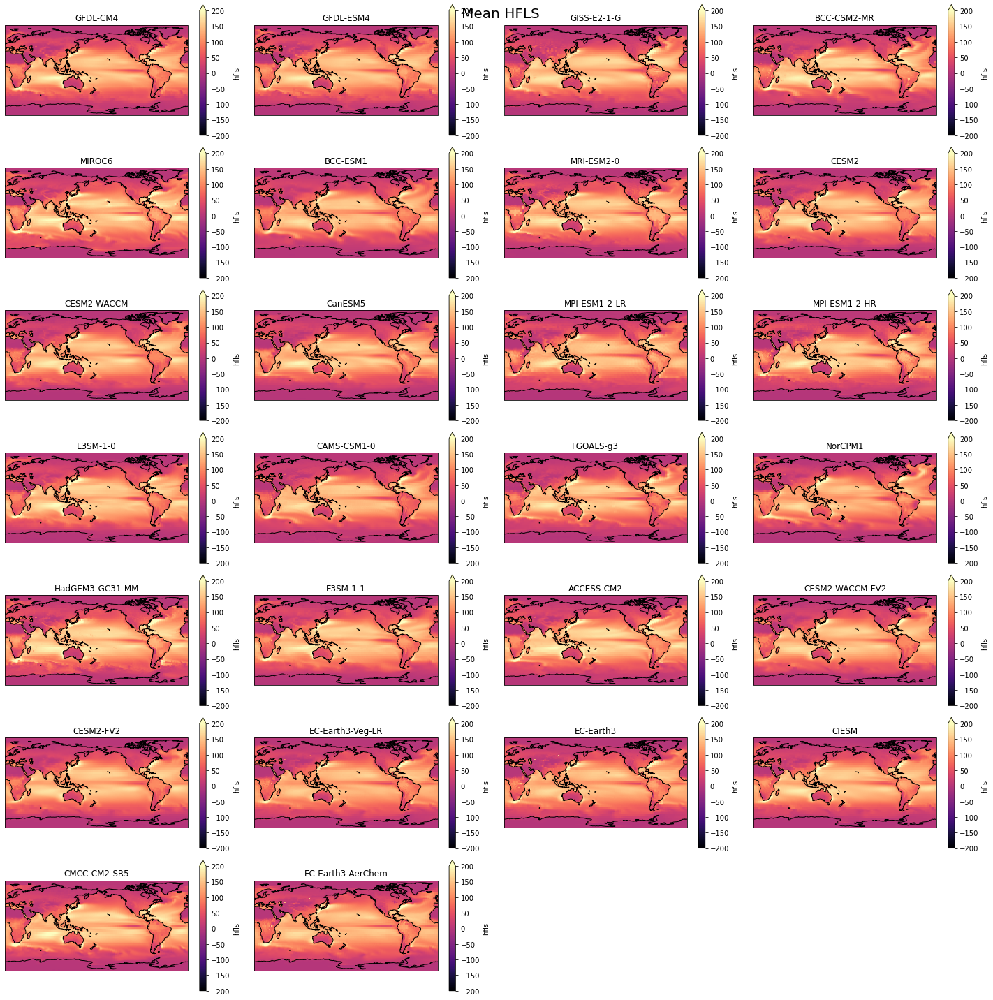

In [23]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in hfls_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    hfls_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-200, vmax=200, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean HFLS', fontsize=20, y=0.99)

### hfss - surface upward sensible heat flux

In [29]:
df_hfss_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'hfss' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_hfss_control = df_hfss_control.drop_duplicates('source_id')
df_hfss_control = df_hfss_control[~df_hfss_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#print(len(df_hfss_control))
#df_hfss_control = df_hfss_control.drop(index=[44319,45957,66835,72921,75905,206265,208936,209029,213493,217593,242430,246455,
#                                              254049,277236,287489,287685,288643,294966,360708,376598,381184,384262,384384])
print(len(df_hfss_control))
df_hfss_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9282,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,hfss,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18358,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,hfss,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32262,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40388,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44319,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20181212
44812,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55603,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
67579,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67679,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
89820,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,hfss,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [30]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_hfss = []
for zstore in df_hfss_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values) 
    ds_hfss_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_hfss = ds_hfss_interp.hfss
    ds_hfss['name'] = name # Creating a new dimension for each ensemble member
    dset_list_hfss.append(ds_hfss)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
BCC-ESM1
<xarray.DataArray 'time' (time: 5412)>
array([cftime.DatetimeNoLeap(1850, 1, 16, 12, 0, 0,

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 8412)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2550, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2550-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2301, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2
<xarray.DataArray 'time' (time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CMCC-CM2-SR5
<xarray.DataArray 'time

In [31]:
hfss_control = xr.concat(dset_list_hfss, dim='name', coords='minimal', compat='override')
hfss_control.load()

<xarray.DataArray 'hfss' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[-5.34074621e+00, -5.37662408e+00, -5.41711926e+00, ...,
          -5.20426350e+00, -5.23735309e+00, -5.27109215e+00],
         [-4.92228622e+00, -4.72836864e+00, -4.65826654e+00, ...,
          -5.26516848e+00, -5.18311703e+00, -5.10283923e+00],
         [-4.67653871e+00, -4.64108994e+00, -4.61191523e+00, ...,
          -5.11042795e+00, -5.03508413e+00, -4.95194411e+00],
         ...,
         [-3.90343190e+00, -3.37735007e+00, -2.84972185e+00, ...,
          -6.42022474e+00, -6.16710186e+00, -5.86036220e+00],
         [-4.77174766e+00, -4.08124102e+00, -3.96473151e+00, ...,
          -6.38221595e+00, -6.10889959e+00, -5.84111226e+00],
         [-6.59251592e+00, -6.63060746e+00, -6.69638157e+00, ...,
          -6.44026337e+00, -6.47829735e+00, -6.51635392e+00]],

        [[-1.44049107e+01, -1.42651426e+01, -1.41449273e+01, ...,
          -1.49800240e+01, -1.48338909e+01, -1.46892420e+01],
         [-1.05620905e+01, -1.02097970e+01, -1.02474599e+01, ...,
          -1.32376546e+01, -1.26140471e+01, -1.19951859e+01],
         [-1.18862037e+01, -1.15760770e+01, -1.12089555e+01, ...,
          -1.42120714e+01, -1.36192348e+01, -1.30256381e+01],
...
         [-1.09929769e+01, -1.14867209e+01, -1.20711531e+01, ...,
          -1.19539739e+01, -1.11200131e+01, -1.09823010e+01],
         [-1.16052038e+01, -1.17243773e+01, -1.18435508e+01, ...,
          -1.11840808e+01, -1.10972702e+01, -1.12766091e+01],
         [-1.09886098e+01, -1.09764525e+01, -1.09642952e+01, ...,
          -1.10689071e+01, -1.10477018e+01, -1.10264968e+01]],

        [[-4.22470476e+00, -4.18913234e+00, -4.15355977e+00, ...,
          -4.59685909e+00, -4.49561121e+00, -4.39436317e+00],
         [-4.34322601e+00, -4.35112562e+00, -4.35902498e+00, ...,
          -4.58671372e+00, -4.47028679e+00, -4.41788270e+00],
         [-5.59239065e+00, -5.50060346e+00, -5.41613954e+00, ...,
          -5.49200723e+00, -5.50810596e+00, -5.55763166e+00],
         ...,
         [-1.31624517e+01, -1.28584976e+01, -1.25498444e+01, ...,
          -1.56284948e+01, -1.50618293e+01, -1.43928826e+01],
         [-1.19981109e+01, -1.16187871e+01, -1.12394635e+01, ...,
          -1.25760205e+01, -1.23723608e+01, -1.22985254e+01],
         [-1.15176646e+01, -1.12586501e+01, -1.09996360e+01, ...,
          -1.21575417e+01, -1.20117212e+01, -1.18659017e+01]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'GFDL-CM4' 'GFDL-ESM4' ... 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Surface Upward Sensible Heat Flux
    original_name:  hfss
    standard_name:  surface_upward_sensible_heat_flux
    units:          W m-2

Text(0.5, 0.99, 'Mean HFSS')

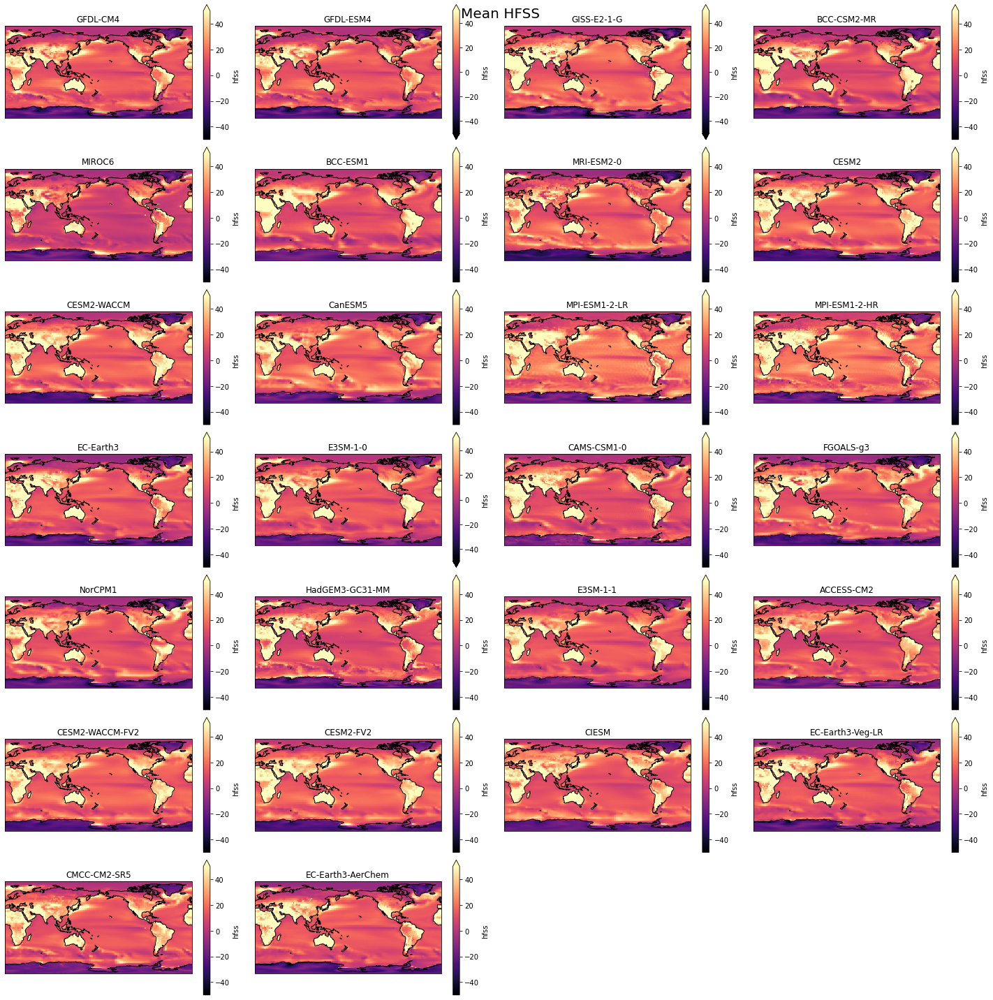

In [10]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in hfss_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    hfss_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean HFSS', fontsize=20, y=0.99)

In [8]:
hfss_control.to_netcdf('/data/keeling/a/mailes2/a/finalized_var_data/CMIP_hfss_26mod_piControl_2x2_last250.nc')

### rlds - surface downwelling longwave flux

In [32]:
df_rlds_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rlds' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rlds_control = df_rlds_control.drop_duplicates('source_id')
df_rlds_control = df_rlds_control[~df_rlds_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_rlds_control = df_rlds_control.drop(index=55639)
#df_rlds_control = df_rlds_control.drop(index=[45956,65223,66847,76027,206295,208933,209033,212665,217914,242475,253990,
#                                             277030,287735,288040,288713,294909,360717,377407,381252,384264,384394])
print(len(df_rlds_control))
df_rlds_control

22


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9353,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rlds,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18475,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rlds,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32240,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40399,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44788,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55639,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65223,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67688,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
67724,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
89889,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [33]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rlds = []
for zstore in df_rlds_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)     
    ds_rlds_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rlds = ds_rlds_interp.rlds
    ds_rlds['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rlds.append(ds_rlds)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 8412)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2550, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2550-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2301, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MIROC6


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2-WACCM
<xarray.DataArray 'time' (time: 5988)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0,

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

In [34]:
rlds_control = xr.concat(dset_list_rlds, dim='name', coords='minimal', compat='override')
rlds_control.load()

<xarray.DataArray 'rlds' (name: 22, time: 3000, lat: 88, lon: 179)>
array([[[[123.49904327, 122.65290604, 121.7804718 , ..., 126.87427444,
          126.03183556, 125.18853531],
         [127.17826309, 126.76212921, 126.30917358, ..., 131.84575424,
          130.6987648 , 129.54889336],
         [138.57890167, 137.40196686, 136.21960068, ..., 143.98793488,
          142.40895462, 140.8567337 ],
         ...,
         [152.73478088, 153.33687592, 153.82386398, ..., 148.789328  ,
          149.05017853, 149.4212616 ],
         [145.76356812, 146.3751236 , 146.56258011, ..., 144.70801468,
          144.8946991 , 145.07583237],
         [141.3912262 , 141.29939651, 141.20713806, ..., 141.74905853,
          141.66098785, 141.57204666]],

        [[103.25864525, 102.73674393, 102.22426414, ..., 105.34780235,
          104.82530594, 104.30293007],
         [112.93401222, 111.66808395, 110.2593174 , ..., 115.20617867,
          114.42937851, 113.65253754],
         [118.54294395, 117.15589867, 115.98392677, ..., 125.93938942,
          124.340662  , 122.71897011],
...
         [219.16067491, 220.88532464, 221.80827705, ..., 213.30081638,
          214.42210142, 217.01955514],
         [203.54154672, 204.03357332, 204.21126556, ..., 200.23521322,
          200.7438168 , 201.31349326],
         [192.82076385, 192.99539057, 193.36637548, ..., 191.53824565,
          191.67747701, 192.14853846]],

        [[161.52234217, 161.32924845, 158.68227844, ..., 165.94639984,
          162.81621017, 158.7883314 ],
         [164.14861832, 161.43425056, 159.67796029, ..., 172.59632204,
          170.08828735, 167.98789512],
         [173.40356523, 171.94590054, 170.55979665, ..., 180.07829344,
          177.36132041, 175.63141106],
         ...,
         [219.64791053, 221.04410794, 220.91175096, ..., 208.04906175,
          212.12220213, 215.80563967],
         [199.30438851, 199.84120009, 200.49501843, ..., 195.01650374,
          196.47840839, 197.59341829],
         [186.76318822, 186.83207265, 186.39096781, ..., 184.48205053,
          185.23554026, 185.91694667]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U15 'GFDL-CM4' 'GFDL-ESM4' ... 'CESM2-FV2' 'CMCC-CM2-SR5'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Surface Downwelling Longwave Radiation
    original_name:  rlds
    standard_name:  surface_downwelling_longwave_flux_in_air
    units:          W m-2

Text(0.5, 0.99, 'Mean RLDS')

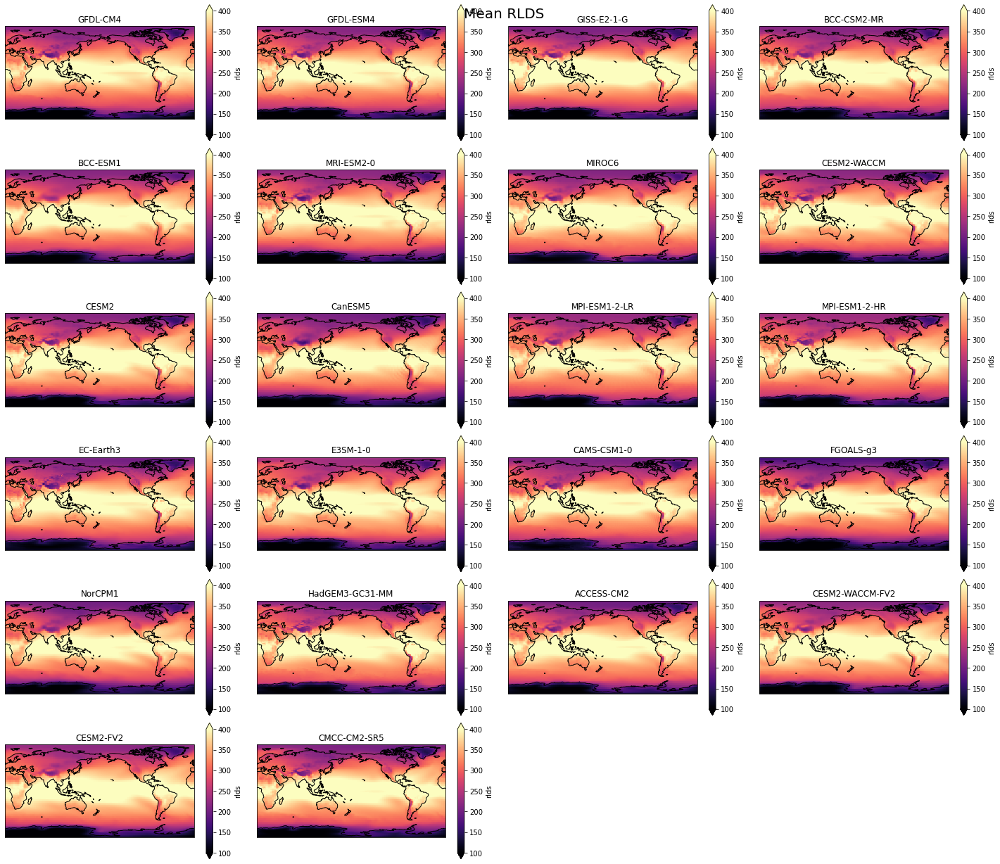

In [9]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rlds_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rlds_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=100, vmax=400, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RLDS', fontsize=20, y=0.99)

In [7]:
rlds_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rlds_22mod_piControl_2x2_last250.nc')

In [34]:
rlds_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rlds_piControl_2x2_250yr.nc')

### rlus - surface upwelling longwave flux

In [3]:
df_rlus_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rlus' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rlus_control = df_rlus_control.drop_duplicates('source_id')
df_rlus_control = df_rlus_control[~df_rlus_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_rlus_control = df_rlus_control.drop(index=[45954,65232,213472,242554,253887,277098,287715,288714,294956,296839,360715,
#                                             376608,377406,381253,384149,384304])
#df_rlus_control = df_rlus_control.drop(index=55744)
#df_rlus_control = df_rlus_control.drop(index=66857)
#df_rlus_control = df_rlus_control.drop(index=67722)
#df_rlus_control = df_rlus_control.drop(index=67749)
#df_rlus_control = df_rlus_control.drop(index=72926)
#df_rlus_control = df_rlus_control.drop(index=76029)
#df_rlus_control = df_rlus_control.drop(index=206305)
#df_rlus_control = df_rlus_control.drop(index=208927)
#df_rlus_control = df_rlus_control.drop(index=209038)

print(len(df_rlus_control))
df_rlus_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9352,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rlus,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18473,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rlus,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32206,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40400,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44836,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55744,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65232,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67722,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67749,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
89846,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [4]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rlus = []
for zstore in df_rlus_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)    
    ds_rlus_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rlus = ds_rlus_interp.rlus
    ds_rlus['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rlus.append(ds_rlus)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 8412)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2550, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2550-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2301, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MIROC6


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2
<xarray.DataArray 'time' (time: 14400)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0, 0, h

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CMCC-CM2-SR5
<xarray.DataArray 'time

In [5]:
rlus_control = xr.concat(dset_list_rlus, dim='name', coords='minimal', compat='override')
rlus_control.load()

<xarray.DataArray 'rlus' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[197.71502914, 197.10239258, 196.48816299, ..., 200.16945496,
          199.55527496, 198.94145966],
         [200.31248779, 199.68279724, 199.20771027, ..., 204.57389374,
          203.51336288, 202.45364609],
         [209.2700119 , 208.08728104, 206.91898727, ..., 214.79303741,
          213.29801559, 211.81130219],
         ...,
         [192.40542374, 193.02702866, 193.58457947, ..., 188.5593483 ,
          188.93968964, 189.41190491],
         [186.51931152, 186.93821259, 186.93885803, ..., 185.44360428,
          185.66215515, 185.87439041],
         [180.80517731, 180.72235413, 180.61782455, ..., 181.13678284,
          181.05384827, 180.97092361]],

        [[162.37527237, 161.78660507, 161.22510147, ..., 164.74912643,
          164.15286636, 163.55835724],
         [166.34949722, 165.06041718, 164.07866669, ..., 171.22294083,
          169.91048431, 168.60285263],
         [173.60237503, 172.10748901, 170.71897125, ..., 181.97248001,
          179.99467087, 178.00788574],
...
         [216.0837689 , 215.95858248, 215.80750204, ..., 214.15956912,
          215.09386839, 215.50900908],
         [213.9919265 , 213.69863439, 213.40535466, ..., 215.09377836,
          214.91414624, 214.60392405],
         [210.02609846, 209.79618233, 209.56627366, ..., 211.23839941,
          210.92486347, 210.61133143]],

        [[215.69167165, 215.43584501, 215.18000881, ..., 217.22187773,
          216.82122268, 216.42056069],
         [215.34765593, 214.86776262, 214.38786638, ..., 218.0838244 ,
          217.28117883, 216.60376209],
         [220.30241588, 218.97880795, 217.6623945 , ..., 225.60135597,
          224.46986899, 223.07995945],
         ...,
         [202.522031  , 202.27087511, 202.02678788, ..., 203.10743429,
          202.72880372, 202.64207062],
         [203.26927077, 203.01227365, 202.75528711, ..., 204.70720689,
          204.34208851, 203.96435792],
         [201.50951094, 201.37658827, 201.24365194, ..., 202.43731651,
          202.19122364, 201.94511873]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'GFDL-CM4' 'GFDL-ESM4' ... 'CIESM' 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      Surface Upwelling Longwave Radiation
    original_name:  rlus
    standard_name:  surface_upwelling_longwave_flux_in_air
    units:          W m-2

Text(0.5, 0.99, 'Mean RLUS')

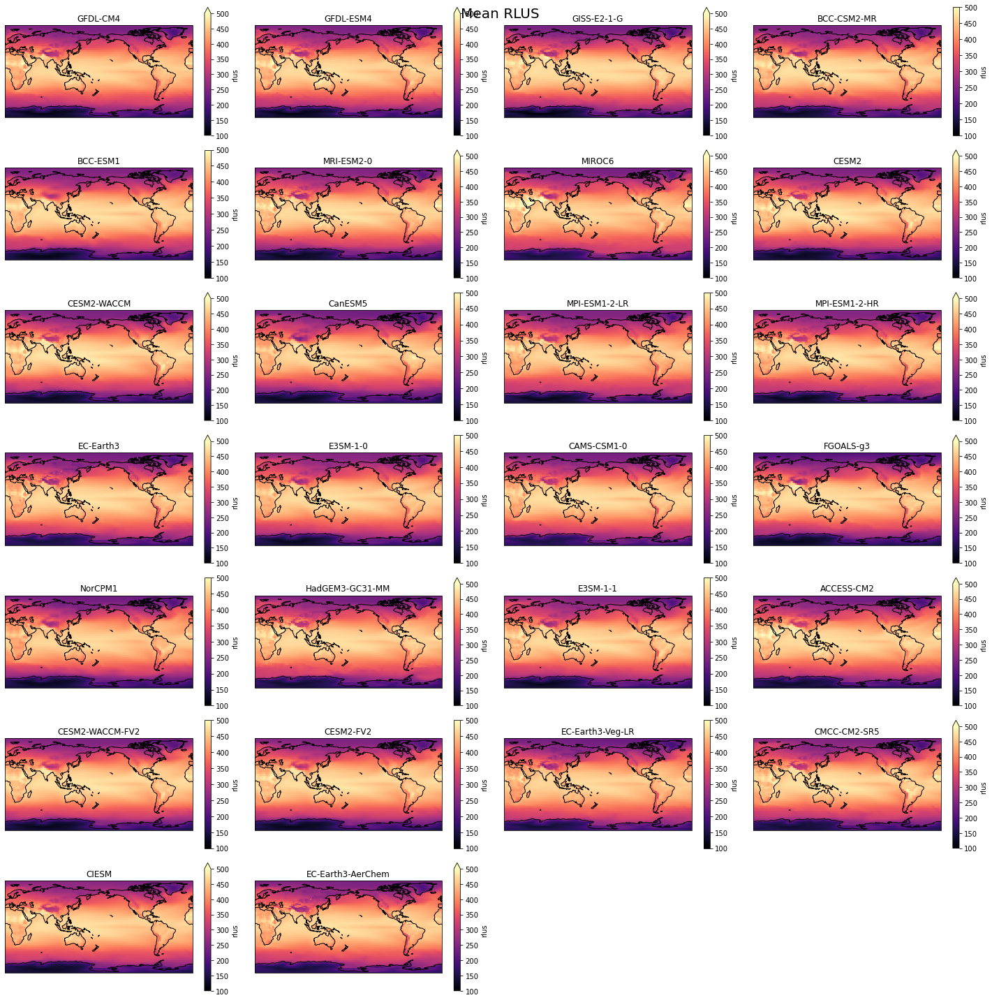

In [7]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rlus_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rlus_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=100, vmax=500, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RLUS', fontsize=20, y=0.99)

In [43]:
rlus_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rlus_piControl_2x2_250yr.nc')

### rsds - surface downwelling shortwave flux

In [12]:
df_rsds_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rsds' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rsds_control = df_rsds_control.drop_duplicates('source_id')
df_rsds_control = df_rsds_control[~df_rsds_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_rsds_control = df_rsds_control.drop(index=[45946,65335,206112,208932,209035,213474,217810,242546,253890,277101,287695,
#                                             287937,288716,294934,360637,376616,377405,381007,384234,384454])
#df_rsds_control = df_rsds_control.drop(index=55748)
#df_rsds_control = df_rsds_control.drop(index=66850)
#df_rsds_control = df_rsds_control.drop(index=67596)
#df_rsds_control = df_rsds_control.drop(index=67752)
#df_rsds_control = df_rsds_control.drop(index=72920)
#df_rsds_control = df_rsds_control.drop(index=75718)
print(len(df_rsds_control))
df_rsds_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
675,CMIP,E3SM-Project,E3SM-1-0,piControl,r1i1p1f1,Amon,rsds,gr,gs://cmip6/CMIP6/CMIP/E3SM-Project/E3SM-1-0/pi...,NaN,20180608
9349,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rsds,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18470,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rsds,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32227,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40404,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44833,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55748,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65335,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67596,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67752,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320


In [13]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rsds = []
for zstore in df_rsds_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)       
    ds_rsds_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rsds = ds_rsds_interp.rsds
    ds_rsds['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rsds.append(ds_rsds)

E3SM-1-0
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(1, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(1, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(1, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(500, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(500, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(500, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0001-01-16 12:00:00 ... 0500-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(251, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(500, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2
<xarray.DataArray 'time' (time: 14400)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0, 0, h

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CAMS-CSM1-0
<xarray.DataArray 'time'

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CMCC-CM2-SR5
<xarray.DataArray 'time

In [14]:
rsds_control = xr.concat(dset_list_rsds, dim='name', coords='minimal', compat='override')
rsds_control.load()

<xarray.DataArray 'rsds' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[3.64912361e+02, 3.65114662e+02, 3.68515518e+02, ...,
          3.60674591e+02, 3.62068939e+02, 3.64774773e+02],
         [3.63017944e+02, 3.67471024e+02, 3.71160439e+02, ...,
          3.55308243e+02, 3.55340370e+02, 3.58629219e+02],
         [3.72191254e+02, 3.72827904e+02, 3.72808678e+02, ...,
          3.66885323e+02, 3.67034897e+02, 3.67408264e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[2.09259518e+02, 2.09361088e+02, 2.11386009e+02, ...,
          2.04241924e+02, 2.06341251e+02, 2.09127167e+02],
         [2.12588173e+02, 2.15125034e+02, 2.17032990e+02, ...,
          2.05595688e+02, 2.05636246e+02, 2.08605713e+02],
         [2.18823082e+02, 2.24469223e+02, 2.24675747e+02, ...,
          2.10518505e+02, 2.10590549e+02, 2.11005386e+02],
...
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[4.47771829e+02, 4.47584853e+02, 4.47397867e+02, ...,
          4.47816579e+02, 4.47830499e+02, 4.47844434e+02],
         [4.50799823e+02, 4.51025090e+02, 4.51250343e+02, ...,
          4.46744807e+02, 4.47761922e+02, 4.48932035e+02],
         [4.53851723e+02, 4.55496630e+02, 4.57097818e+02, ...,
          4.46268183e+02, 4.48080692e+02, 4.50049982e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'E3SM-1-0' 'GFDL-CM4' ... 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    comment:        Surface solar irradiance for UV calculations.
    long_name:      Surface Downwelling Shortwave Radiation
    standard_name:  surface_downwelling_shortwave_flux_in_air
    units:          W m-2

Text(0.5, 0.99, 'Mean RSDS')

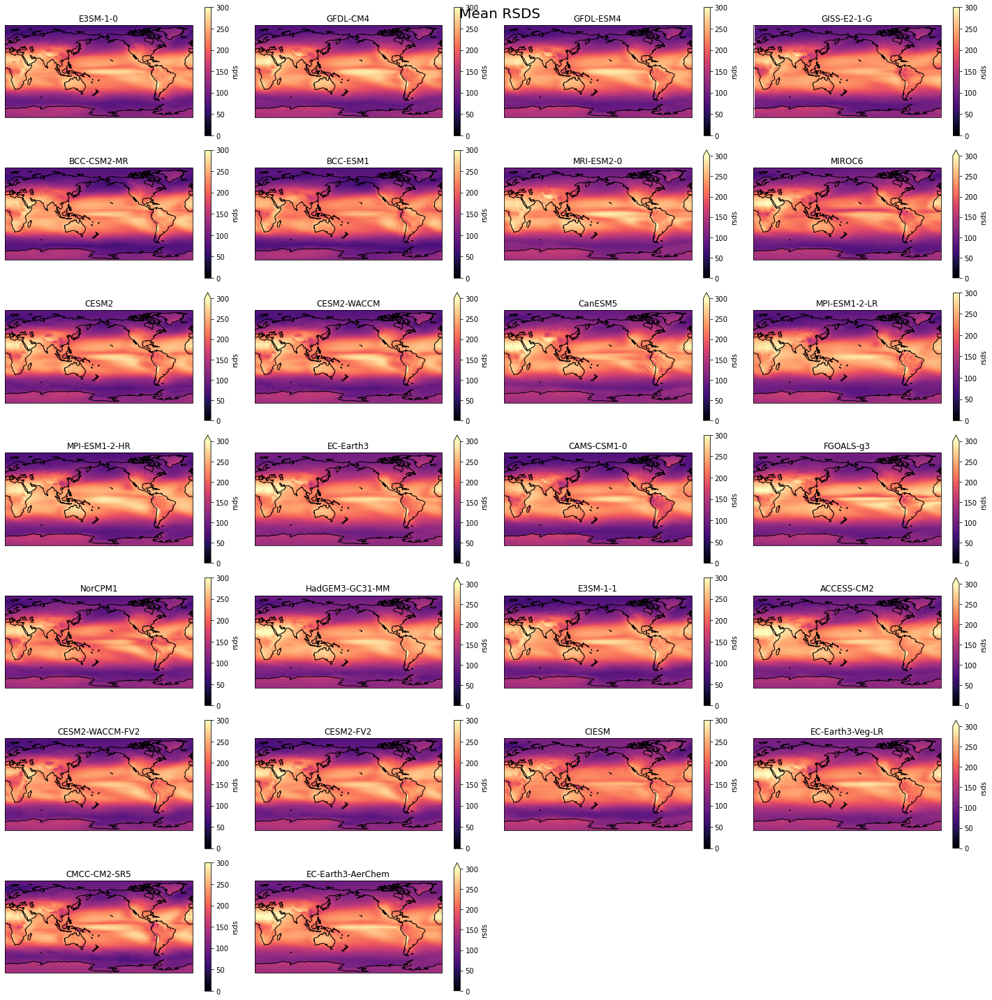

In [17]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rsds_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rsds_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=300, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RSDS', fontsize=20, y=0.99)

In [52]:
rsds_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rsds_piControl_2x2_250yr.nc')

### rsus - surface upwelling shortwave flux

In [20]:
df_rsus_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rsus' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rsus_control = df_rsus_control.drop_duplicates('source_id')
df_rsus_control = df_rsus_control[~df_rsus_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_rsus_control = df_rsus_control.drop(index=[45941,65316,66852,72892,75721,206245,208931,209048,213477,217808,253873,
#                                             277104,287744,288692,294948,296836,360668,376610,377404,381028,384443,
#                                             385519])
print(len(df_rsus_control))
df_rsus_control

23


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9346,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rsus,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18485,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rsus,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32230,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40409,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44830,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55684,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65316,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67552,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67727,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
89834,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,rsus,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [21]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rsus = []
for zstore in df_rsus_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)     
    ds_rsus_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rsus = ds_rsus_interp.rsus
    ds_rsus['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rsus.append(ds_rsus)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 8412)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2550, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2550-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2301, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2550, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MIROC6


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2
<xarray.DataArray 'time' (time: 14400)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0, 0, h

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

In [22]:
rsus_control = xr.concat(dset_list_rsus, dim='name', coords='minimal', compat='override')
rsus_control.load()

<xarray.DataArray 'rsus' (name: 23, time: 3000, lat: 88, lon: 179)>
array([[[[3.30427060e+02, 3.30476402e+02, 3.30650726e+02, ...,
          3.30232851e+02, 3.30280945e+02, 3.30329320e+02],
         [3.26498770e+02, 3.27351904e+02, 3.28167389e+02, ...,
          3.25572093e+02, 3.25618431e+02, 3.25664929e+02],
         [3.22258606e+02, 3.22363875e+02, 3.22646881e+02, ...,
          3.19895445e+02, 3.19923820e+02, 3.20028421e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[1.91105544e+02, 1.91170558e+02, 1.91237213e+02, ...,
          1.90849834e+02, 1.90913116e+02, 1.90976804e+02],
         [1.83983823e+02, 1.85089597e+02, 1.86153774e+02, ...,
          1.84485196e+02, 1.84504620e+02, 1.84524136e+02],
         [1.86716749e+02, 1.86573482e+02, 1.86393921e+02, ...,
          1.82781989e+02, 1.82805374e+02, 1.82994962e+02],
...
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[3.77942225e+02, 3.77612870e+02, 3.77294123e+02, ...,
          3.76559096e+02, 3.76995237e+02, 3.77441194e+02],
         [3.78847467e+02, 3.78021592e+02, 3.77142402e+02, ...,
          3.76700117e+02, 3.77509925e+02, 3.78224469e+02],
         [3.76004977e+02, 3.76572336e+02, 3.77012579e+02, ...,
          3.75022848e+02, 3.75589701e+02, 3.75737019e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U15 'GFDL-CM4' 'GFDL-ESM4' ... 'CMCC-CM2-SR5' 'CIESM'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order1
    long_name:      Surface Upwelling Shortwave Radiation
    original_name:  rsus
    standard_name:  surface_upwelling_shortwave_flux_in_air
    units:          W m-2

Text(0.5, 0.99, 'Mean RSUS')

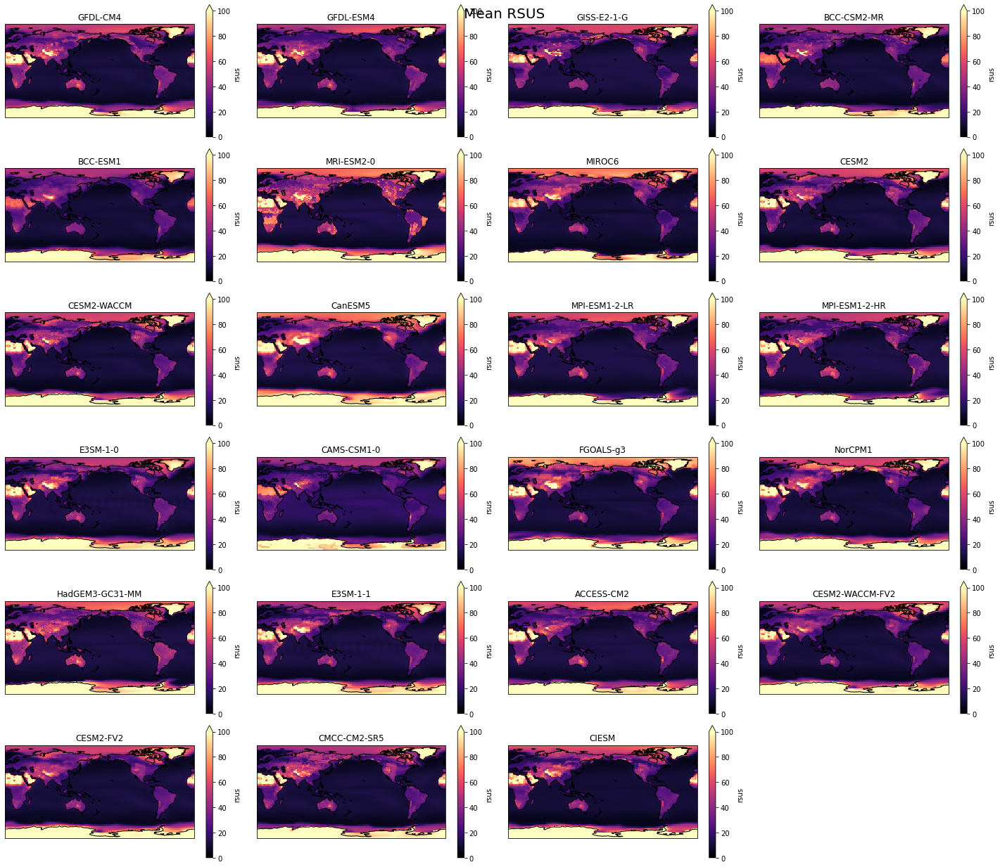

In [25]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rsus_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rsus_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=100, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RSUS', fontsize=20, y=0.99)

In [51]:
rsus_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rsus_piControl_2x2_250yr.nc')

# Total surface flux

In [38]:
models = ['ACCESS-CM2','BCC-CSM2-MR','BCC-ESM1','CAMS-CSM1-0','CanESM5','CESM2','CESM2-FV2','CESM2-WACCM','CESM2-WACCM-FV2',
          'CMCC-CM2-SR5','E3SM-1-0','FGOALS-g3','GFDL-CM4','GFDL-ESM4','GISS-E2-1-G','MIROC6','MPI-ESM1-2-HR','MPI-ESM1-2-LR',
          'MRI-ESM2-0','NorCPM1','HadGEM3-GC31-MM']
rsds_control_trunc = rsds_control.sel(name=models)
rlds_control_trunc = rlds_control.sel(name=models)
hfss_control_trunc = hfss_control.sel(name=models)
rsus_control_trunc = rsus_control.sel(name=models)
rlus_control_trunc = rlus_control.sel(name=models)
hfls_control_trunc = hfls_control.sel(name=models)

In [39]:
surface_control_trunc = (rsds_control_trunc + rlds_control_trunc - hfss_control_trunc - rsus_control_trunc - rlus_control_trunc
                        - hfls_control_trunc)
surface_control_trunc

<xarray.DataArray (name: 21, time: 3000, lat: 88, lon: 179)>
array([[[[ 2.70404846e+00,  2.81563293e+00,  2.87880046e+00, ...,
           2.39552104e+00,  2.44720561e+00,  2.53910248e+00],
         [ 2.29113261e+00,  2.34780579e+00,  2.40282694e+00, ...,
           2.07070262e+00,  2.13246409e+00,  2.16494446e+00],
         [ 2.23157725e+00,  2.29724365e+00,  2.30232137e+00, ...,
           1.92388784e+00,  1.97010854e+00,  2.09777069e+00],
         ...,
         [-3.18850011e+01, -3.25678207e+01, -3.30600011e+01, ...,
          -2.74081612e+01, -2.88435272e+01, -3.00602231e+01],
         [-3.03557058e+01, -3.04210571e+01, -3.06069539e+01, ...,
          -2.88049764e+01, -2.92998759e+01, -2.97921021e+01],
         [-3.08945734e+01, -3.07309384e+01, -3.08277166e+01, ...,
          -3.05147894e+01, -3.07084763e+01, -3.07217334e+01]],

        [[ 2.11473490e-01,  2.37011566e-01,  2.75037130e-01, ...,
           1.27258504e-01,  1.64216105e-01,  1.82848663e-01],
         [ 1.17210897e-01,  1.57866669e-01,  2.26710002e-01, ...,
           4.00314331e-02,  6.40004476e-02,  8.34449768e-02],
         [ 2.21938833e-01,  2.36208344e-01,  2.55773163e-01, ...,
           5.92071025e-02,  1.25177511e-01,  1.25488739e-01],
...
         [-2.03957379e+01, -1.98282972e+01, -1.90399510e+01, ...,
          -2.35250181e+01, -2.29488490e+01, -2.12981590e+01],
         [-1.95618551e+01, -2.00169237e+01, -2.03563198e+01, ...,
          -2.03836751e+01, -2.06994231e+01, -2.12270359e+01],
         [-1.95738040e+01, -1.95924932e+01, -1.95589603e+01, ...,
          -1.90983718e+01, -1.89683602e+01, -1.91996303e+01]],

        [[ 1.91400140e+00,  1.93072991e+00,  1.94663507e+00, ...,
           1.87315362e+00,  1.88648041e+00,  1.89450200e+00],
         [ 1.81488037e+00,  1.84705810e+00,  1.87526703e+00, ...,
           1.70287488e+00,  1.73093438e+00,  1.75809060e+00],
         [ 1.73660584e+00,  1.78348054e+00,  1.83045651e+00, ...,
           1.63874587e+00,  1.67280912e+00,  1.69599672e+00],
         ...,
         [-3.70187466e+01, -3.61013547e+01, -3.51745975e+01, ...,
          -3.63131066e+01, -3.81721818e+01, -3.98689894e+01],
         [-3.15357298e+01, -3.21579148e+01, -3.15622492e+01, ...,
          -2.95161267e+01, -3.05341696e+01, -3.10027064e+01],
         [-3.06426340e+01, -2.93917632e+01, -2.85876464e+01, ...,
          -2.94877832e+01, -3.12457257e+01, -3.16216427e+01]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'ACCESS-CM2' 'BCC-CSM2-MR' ... 'HadGEM3-GC31-MM'

In [40]:
surface_control_trunc == surface_control

<xarray.DataArray (name: 21, time: 3000, lat: 88, lon: 179)>
array([[[[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]],

        [[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]],

        [[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
...
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]],

        [[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]],

        [[ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         ...,
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True],
         [ True,  True,  True, ...,  True,  True,  True]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'ACCESS-CM2' 'BCC-CSM2-MR' ... 'HadGEM3-GC31-MM'

In [35]:
surface_control = (rsds_control + rlds_control - hfss_control - rsus_control - rlus_control
                  - hfls_control)
surface_control

<xarray.DataArray (name: 21, time: 3000, lat: 88, lon: 179)>
array([[[[  6.89305654,   6.8988515 ,   7.09300643, ...,   5.85671151,
            6.10371307,   6.84439732],
         [  7.55672467,   7.45326029,   7.37832551, ...,   5.9413929 ,
            5.9514367 ,   6.67839181],
         [  7.36254704,   7.71797562,   7.76862723, ...,   6.13466319,
            6.12888318,   6.20862055],
         ...,
         [-23.42462632, -25.59897861, -25.74167001, ..., -23.71710423,
          -23.7372489 , -23.74380498],
         [-23.34033093, -24.11804114, -24.52494669, ..., -24.66627973,
          -24.64710599, -24.04010473],
         [-23.97302213, -23.96958658, -23.60134226, ..., -25.6845866 ,
          -24.83509189, -24.00396284]],

        [[ -0.66262729,  -0.67683224,  -0.98192035, ...,  -0.42063934,
           -0.50114243,  -0.6531758 ],
         [ -1.32390799,  -1.54676446,  -1.72148068, ...,  -0.70138421,
           -0.70612739,  -0.96137679],
         [ -1.15760401,  -1.66036669,  -1.70326976, ...,  -0.7132649 ,
           -0.70778125,  -0.73060639],
...
         [-31.60632973, -30.95446449, -30.86270911, ..., -30.75660913,
          -31.46685142, -31.1258408 ],
         [-32.97804385, -32.71526427, -33.09716808, ..., -35.34170248,
          -34.88096489, -34.40730262],
         [-32.13294745, -31.9889238 , -31.79282144, ..., -33.23032722,
          -33.24692395, -32.70260559]],

        [[ 13.56814985,  13.62354371,  12.90354076, ...,  13.45118534,
           13.21824339,  12.102802  ],
         [ 13.27546615,  12.9112666 ,  13.22179476, ...,  13.14525152,
           12.76635245,  13.06083141],
         [ 13.7967019 ,  13.85402829,  13.78237608, ...,  13.98558622,
           13.61855972,  13.59453026],
         ...,
         [-21.32803491, -21.32113724, -21.78701979, ..., -18.97707509,
          -19.65047923, -19.51493823],
         [-24.44941973, -24.65614411, -25.24031314, ..., -23.40400777,
          -23.90770223, -24.01629599],
         [-26.25547412, -26.42860821, -27.08746047, ..., -26.7839087 ,
          -26.87428337, -26.41417148]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'E3SM-1-0' 'GFDL-CM4' ... 'CESM2-FV2' 'CMCC-CM2-SR5'

In [54]:
surface_control_trunc.to_netcdf('/data/keeling/a/mailes2/a/finalized_var_data/CMIP_surface_21mod_piControl_2x2_last250.nc')

In [35]:
surface_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_surface_piControl_2x2_250yr_24mod.nc')

In [38]:
surface_control = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_surface_piControl_2x2_250yr_24mod.nc')

In [74]:
# 15 model
surface_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_surface_piControl_2x2_250yr.nc')

In [46]:
surface_control = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_surface_piControl_2x2_250yr.nc')

Text(0.5, 0.99, 'Mean Surface Flux')

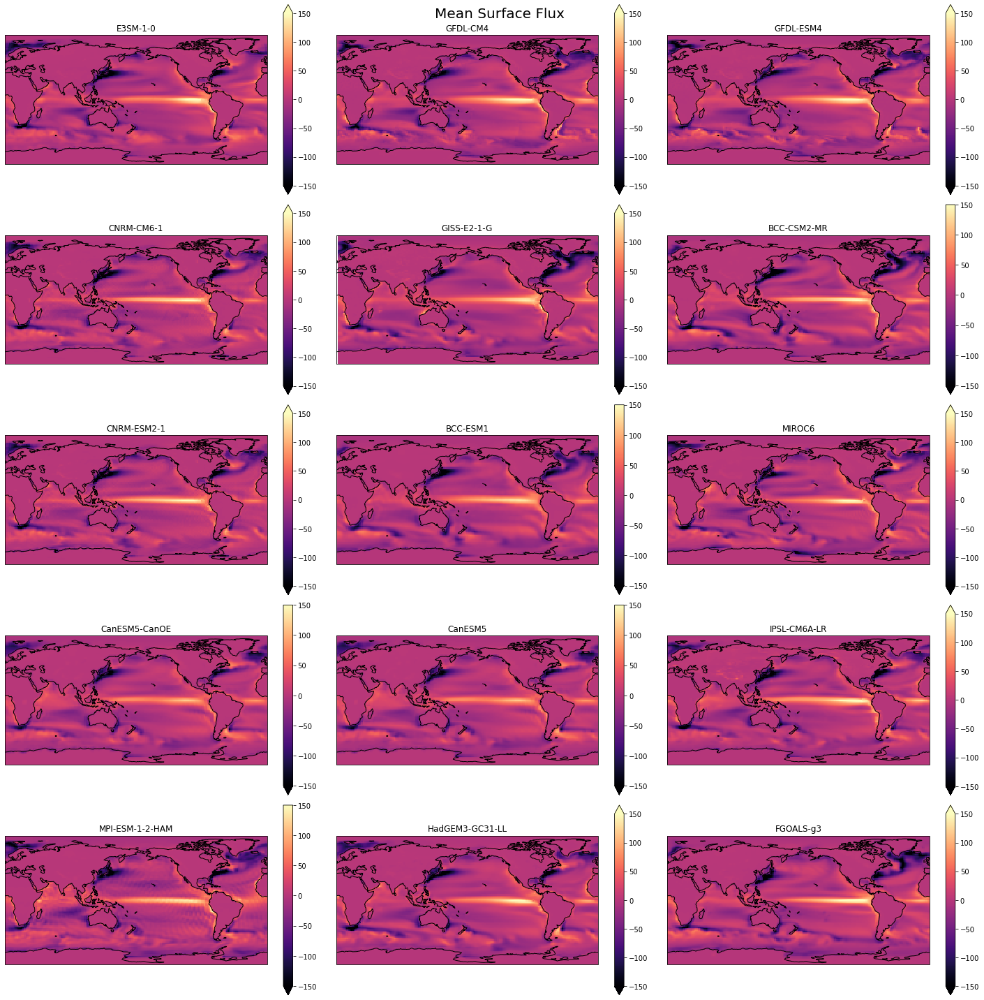

In [65]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in surface_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    surface_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-150, vmax=150, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean Surface Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Mean Surface Flux')

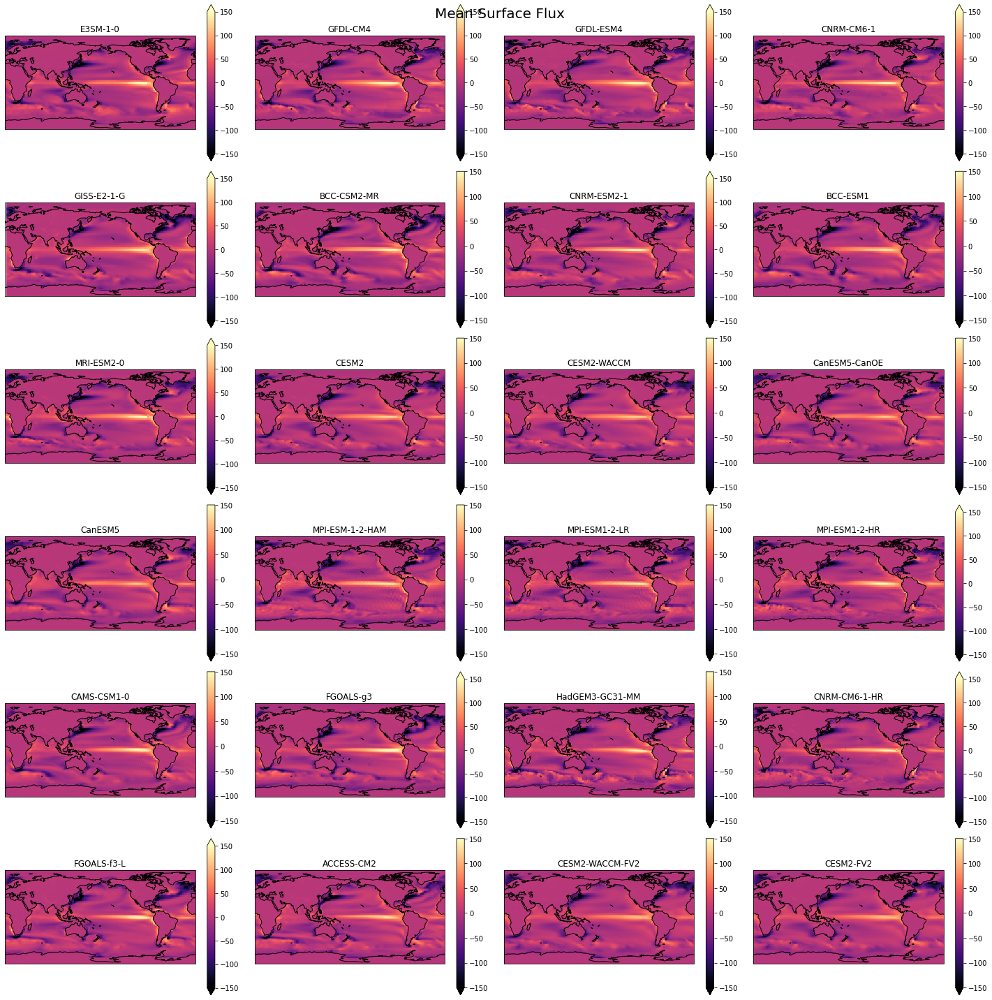

In [37]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in surface_control['name'].values:
    ax = fig.add_subplot(6,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    surface_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-150, vmax=150, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean Surface Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Mean Surface Flux')

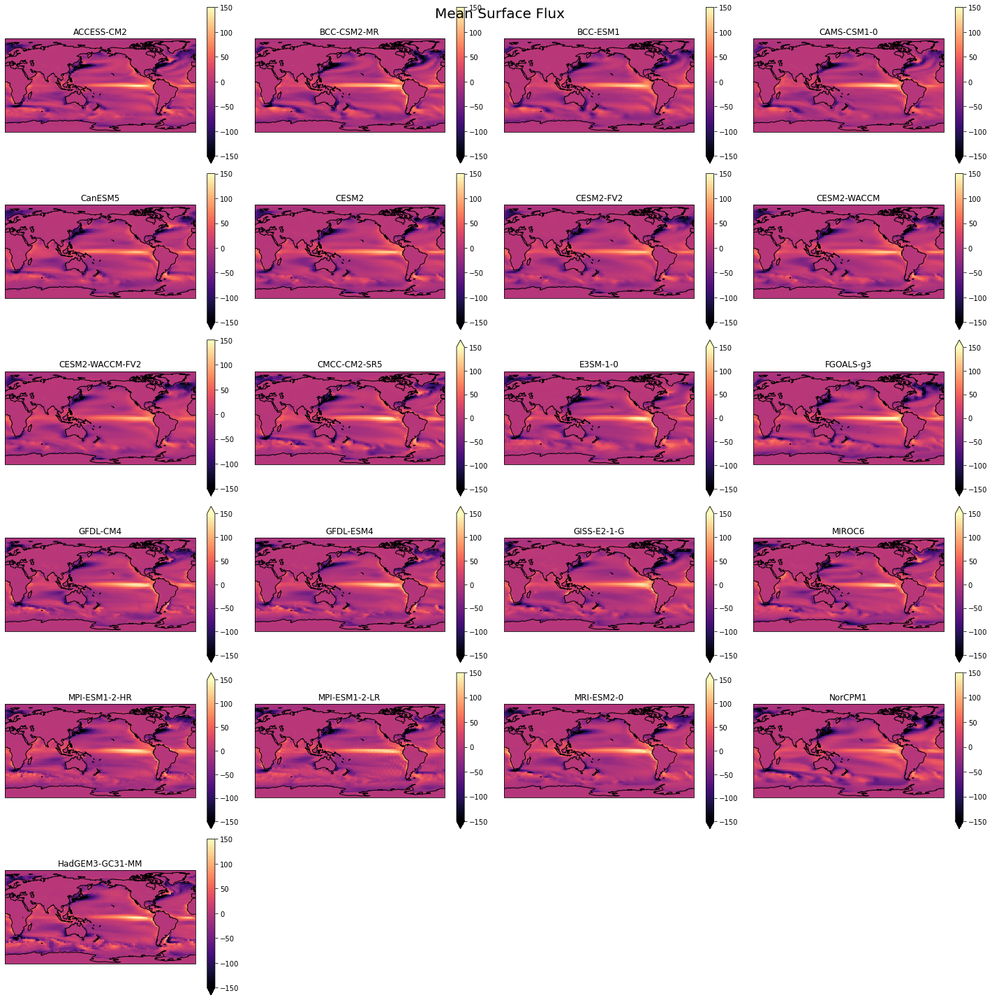

In [52]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in surface_control_trunc['name'].values:
    ax = fig.add_subplot(6,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    surface_control_trunc.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-150, vmax=150, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean Surface Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Mean Surface Flux')

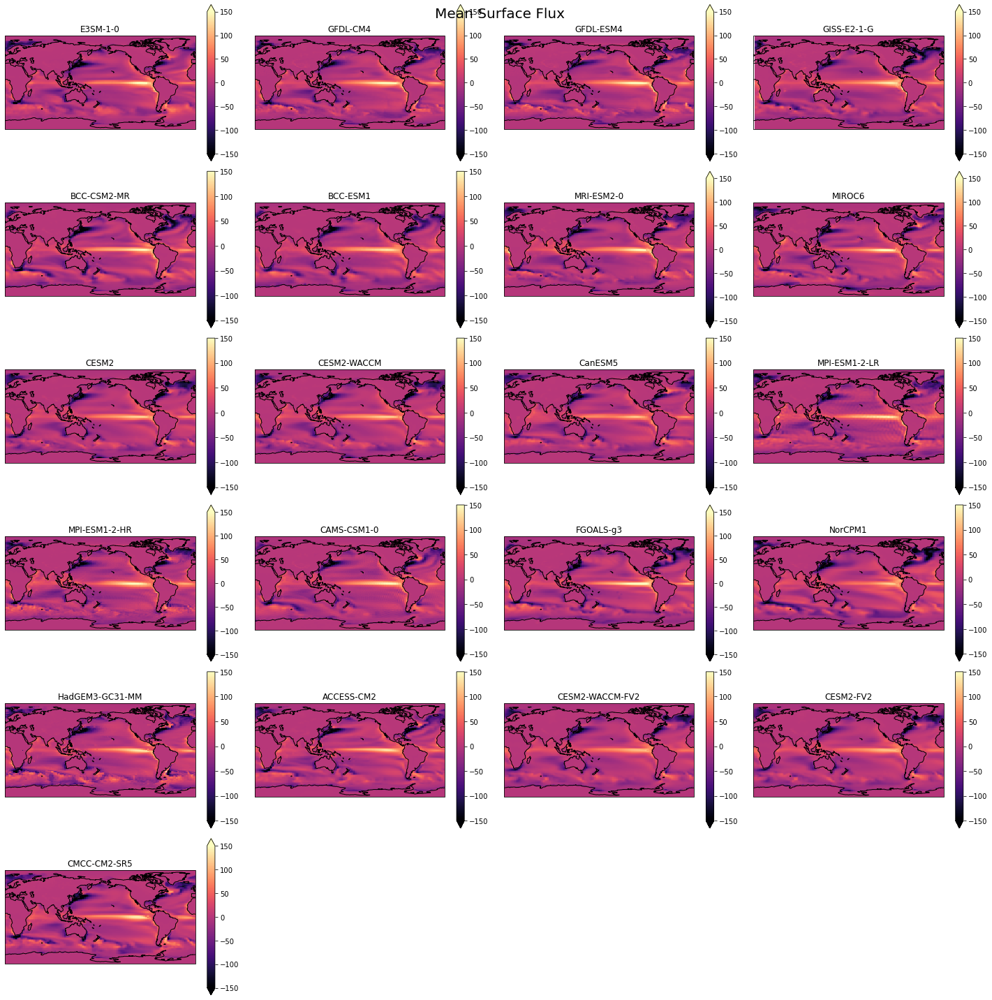

In [53]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in surface_control['name'].values:
    ax = fig.add_subplot(6,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    surface_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-150, vmax=150, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean Surface Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Surface Flux Interdecadal Variability (>25 years)')

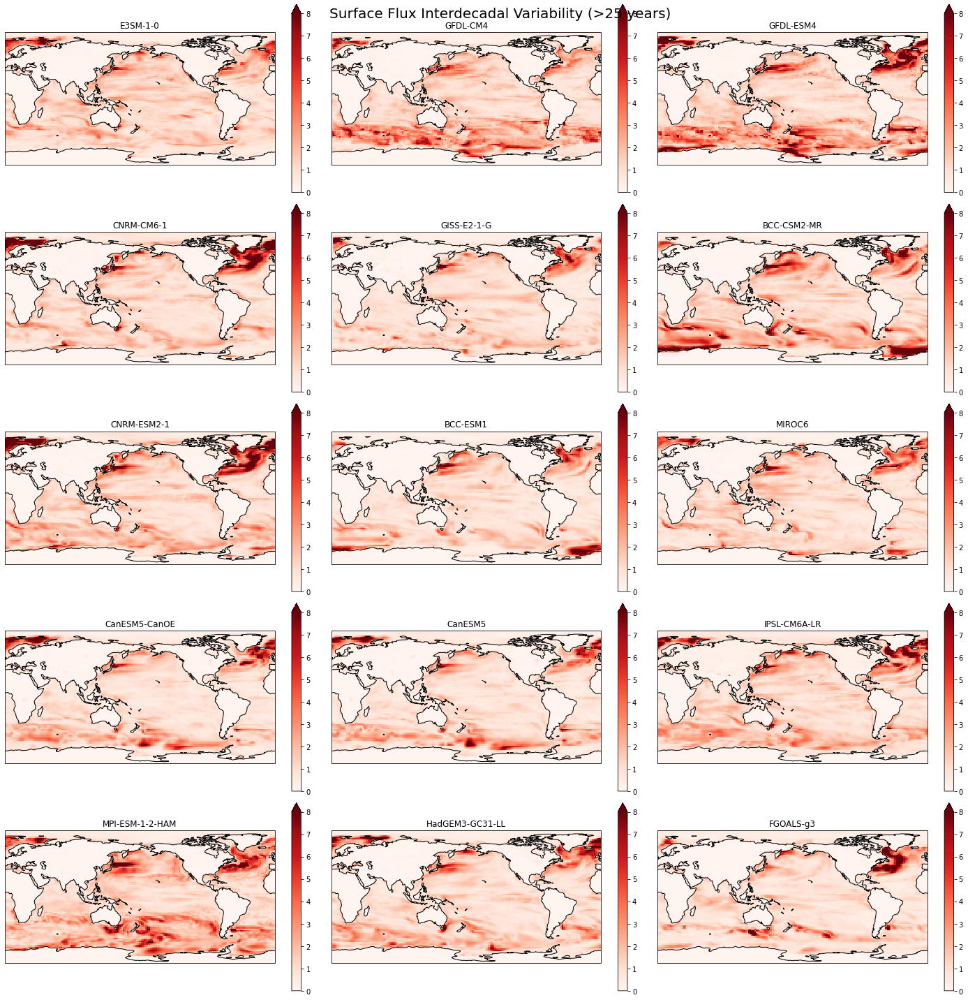

In [69]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in surface_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    rolling = surface_control.sel(name=model).rolling(time=300, center=True).mean('time')
    rolling.std('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Reds')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Surface Flux Interdecadal Variability (>25 years)', fontsize=20, y=0.99)

In [70]:
surface_rolling = surface_control.rolling(time=300, center=True).mean('time')
surface_stand = surface_rolling.std('time')
surface_var = surface_stand.mean('name')

Text(0.5, 1.0, '25 year Surface Flux interdecadal variability (N=15)')

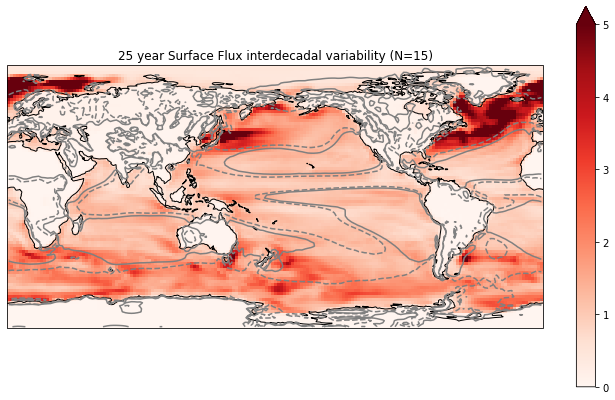

In [73]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
surface_var.plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=5, cmap='Reds')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('25 year Surface Flux interdecadal variability (N=15)')

# TOA Fluxes

### rsdt  - toa downwelling shortwave flux

In [57]:
df_rsdt_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rsdt_control = df_rsdt_control.drop_duplicates('source_id')
df_rsdt_control = df_rsdt_control[~df_rsdt_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
print(len(df_rsdt_control))
#df_rsdt_control = df_rsdt_control.drop(index=101)
#df_rsdt_control = df_rsdt_control.drop(index=[45940,65324,66851,72904,75720,206247,208940,209032,213476,217809,242598,
#                                             253882,277112,287745,288717,294939,360650,375346,376615,381005,384444,385503])
#df_rsdt_control = df_rsdt_control.drop(index=55709)
#df_rsdt_control = df_rsdt_control.drop(index=66851)
#df_rsdt_control = df_rsdt_control.drop(index=67586)
#df_rsdt_control = df_rsdt_control.drop(index=67728)
#df_rsdt_control = df_rsdt_control.drop(index=72904)
#df_rsdt_control = df_rsdt_control.drop(index=75720)

df_rsdt_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
101,CMIP,MOHC,HadGEM3-GC31-MM,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/MOHC/HadGEM3-GC31-MM/piC...,NaN,20170831
9347,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rsdt,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18468,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rsdt,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32228,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40406,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44831,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55709,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65324,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67586,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67728,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rsdt,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320


In [59]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rsdt = []
for zstore in df_rsdt_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)      
    ds_rsdt_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rsdt = ds_rsdt_interp.rsdt
    ds_rsdt['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rsdt.append(ds_rsdt)

HadGEM3-GC31-MM
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetime360Day(1850, 1, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.Datetime360Day(1850, 2, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.Datetime360Day(1850, 3, 16, 0, 0, 0, 0, has_year_zero=True), ...,
       cftime.Datetime360Day(2349, 10, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.Datetime360Day(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.Datetime360Day(2349, 12, 16, 0, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 00:00:00 ... 2349-12-16 00:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.Datetime360Day(2100, 1, 16, 0, 0, 0, 0, has_year_zero=True)]
[cftime.Datetime360Day(2349, 12, 16, 0, 0, 0, 0, has_year_zero=True)]
GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
      

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2
<xarray.DataArray 'time' (time: 14400)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0, 0, h

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CMCC-CM2-SR5
<xarray.DataArray 'time

In [60]:
rsdt_control = xr.concat(dset_list_rsdt, dim='name', coords='minimal', compat='override')
rsdt_control.load()

<xarray.DataArray 'rsdt' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[5.00157477e+02, 5.00157477e+02, 5.00157477e+02, ...,
          5.00157477e+02, 5.00157477e+02, 5.00157477e+02],
         [4.98934250e+02, 4.98934250e+02, 4.98934250e+02, ...,
          4.98934250e+02, 4.98934250e+02, 4.98934250e+02],
         [4.97110640e+02, 4.97110640e+02, 4.97110640e+02, ...,
          4.97110640e+02, 4.97110640e+02, 4.97110640e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[3.07317560e+02, 3.07317560e+02, 3.07317560e+02, ...,
          3.07317560e+02, 3.07317560e+02, 3.07317560e+02],
         [3.06565948e+02, 3.06565948e+02, 3.06565948e+02, ...,
          3.06565948e+02, 3.06565948e+02, 3.06565948e+02],
         [3.05445458e+02, 3.05445458e+02, 3.05445458e+02, ...,
          3.05445458e+02, 3.05445458e+02, 3.05445458e+02],
...
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[5.48637213e+02, 5.48637234e+02, 5.48637239e+02, ...,
          5.48637248e+02, 5.48637213e+02, 5.48637208e+02],
         [5.47314638e+02, 5.47314451e+02, 5.47314259e+02, ...,
          5.47313800e+02, 5.47314067e+02, 5.47314339e+02],
         [5.45327150e+02, 5.45327275e+02, 5.45327386e+02, ...,
          5.45326731e+02, 5.45327406e+02, 5.45327279e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'HadGEM3-GC31-MM' 'GFDL-CM4' ... 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    comment:        Shortwave radiation incident at the top of the atmosphere
    history:        2019-09-17T21:08:57Z altered by CMOR: replaced missing va...
    long_name:      TOA Incident Shortwave Radiation
    original_name:  mo: (stash: m01s01i207, lbproc: 128)
    standard_name:  toa_incoming_shortwave_flux
    units:          W m-2

Text(0.5, 0.99, 'Mean RSDT')

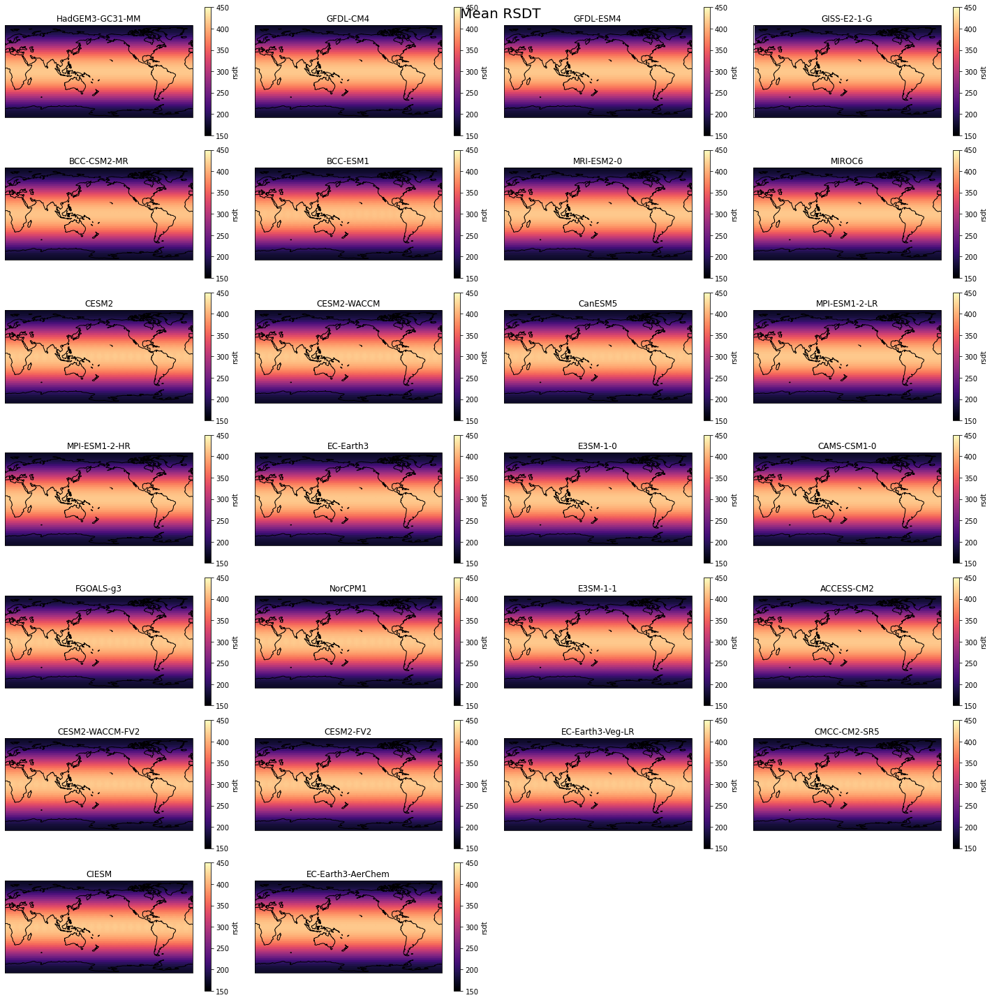

In [62]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rsdt_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rsdt_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=150, vmax=450,cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RSDT', fontsize=20, y=0.99)

In [ ]:
rsdt_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rsdt_piControl_2x2_250yr_24yr.nc')

In [13]:
rsdt_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rsdt_piControl_2x2_250yr.nc')

### rsut - shortwave upwards toa flux 

In [66]:
df_rsut_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rsut' & experiment_id == 'piControl' & member_id=='r1i1p1f1'")
df_rsut_control = df_rsut_control.drop_duplicates('source_id')
df_rsut_control = df_rsut_control[~df_rsut_control['source_id'].isin(['MCM-UA-1-0','GISS-E2-1-G-CC','NorESM1-F','IITM-ESM',
                                                                  'GISS-E2-2-G','AWI-ESM-1-1-LR','EC-Earth3-LR',
                                                                  'E3SM-1-1-ECA','MIROC-ES2H','ICON-ESM-LR',
                                                                  'KIOST-ESM','NESM3','KACE-1-0-G','GISS-E2-1-H','MPI-ESM-1-2-HAM',
                                                                  'HadGEM3-GC31-LL','EC-Earth3-Veg','CAS-ESM2-0','FIO-ESM-2-0',
                                                                  'CNRM-CM6-1','AWI-CM-1-1-MR','FGOALS-f3-L','IPSL-CM6A-LR',
                                                                  'ACCESS-ESM1-5','CNRM-ESM2-1','CanESM5-CanOE','MIROC-ES2L',
                                                                     'CNRM-CM6-1-HR','UKESM1-0-LL','NorESM2-MM','SAM0-UNICON',
                                                                      'TaiESM1','INM-CM4-8','INM-CM5-0'])]
#df_rsut_control = df_rsut_control.drop(index=[45950,65290,66853,206183,209031,213479,217807,242553,242803,253855,277096,
#                                             287711,288720,294950,360669,375354,376612,381510,384500,385534])
#df_rsut_control = df_rsut_control.drop(index=55662)
#df_rsut_control = df_rsut_control.drop(index=66853)
#df_rsut_control = df_rsut_control.drop(index=67550)
#df_rsut_control = df_rsut_control.drop(index=67755)
#df_rsut_control = df_rsut_control.drop(index=75723)
print(len(df_rsut_control))
df_rsut_control

26


,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9405,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rsut,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18487,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rsut,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
32239,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40411,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
44877,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55662,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
65290,CMIP,MIROC,MIROC6,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/MIROC/MIROC6/piControl/r...,NaN,20190311
67550,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67755,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320
89818,CMIP,CCCma,CanESM5,piControl,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/CMIP/CCCma/CanESM5/piControl/...,NaN,20190429


In [67]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rsut = []
for zstore in df_rsut_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    print(ds.time)
    ds_sel = ds.isel(time=slice(len(ds.time)-3000,len(ds.time)))
    print(ds_sel.time.head(1).values)
    print(ds_sel.time.tail(1).values)      
    ds_rsut_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rsut = ds_rsut_interp.rsut
    ds_rsut['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rsut.append(ds_rsut)

GFDL-CM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeNoLeap(151, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(151, 3, 16, 12, 0, 0, 0, has_year_zero=True), ...,
       cftime.DatetimeNoLeap(650, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0151-01-16 12:00:00 ... 0650-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    calendar_type:  noleap
    description:    for time-mean fields
    long_name:      time
    standard_name:  time
[cftime.DatetimeNoLeap(401, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeNoLeap(650, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
GFDL-ESM4
<xarray.DataArray 'time' (time: 6000)>
array([cftime.Datetim

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 9600)>
array([cftime.DatetimeGregorian(3200, 1, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 2, 15, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3200, 3, 16, 12, 0, 0, 0, has_year_zero=False),
       ...,
       cftime.DatetimeGregorian(3999, 10, 16, 12, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 11, 16, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)],
      dtype=object)
Coordinates:
  * time     (time) object 3200-01-16 12:00:00 ... 3999-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeGregorian(3750, 1, 16, 12, 0, 0, 0, has_year_zero=False)]
[cftime.DatetimeGregorian(3999, 12, 16, 12, 0, 0, 0, has_year_zero=False)]
CESM2
<xarray.DataArray 'time' (time: 14400)>
array([cftime.DatetimeNoLeap(1, 1, 15, 12, 0, 0, 0, h

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 12000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2849, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2849-12-16 12:00:00
Attributes:
    _ChunkSizes:    1
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2600, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2849, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
MPI-ESM1-2-HR

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(1850, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1850, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2349, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2349-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2100, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2349, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
EC-Earth3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2259, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2259, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2759, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2259-01-16 12:00:00 ... 2759-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2510, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2759, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
E3SM-1-0
<xarray.DataArray 'time' (t

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

<xarray.DataArray 'time' (time: 6000)>
array([cftime.DatetimeProlepticGregorian(950, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(950, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(1449, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 0950-01-16 12:00:00 ... 1449-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(1200, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(1449, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CESM2-WACCM-FV2
<xarray.DataArray 'time

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


<xarray.DataArray 'time' (time: 6012)>
array([cftime.DatetimeProlepticGregorian(2300, 1, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 2, 15, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2300, 3, 16, 12, 0, 0, 0, has_year_zero=True),
       ...,
       cftime.DatetimeProlepticGregorian(2800, 10, 16, 12, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 11, 16, 0, 0, 0, 0, has_year_zero=True),
       cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)],
      dtype=object)
Coordinates:
  * time     (time) object 2300-01-16 12:00:00 ... 2800-12-16 12:00:00
Attributes:
    axis:           T
    bounds:         time_bnds
    long_name:      time
    standard_name:  time
[cftime.DatetimeProlepticGregorian(2551, 1, 16, 12, 0, 0, 0, has_year_zero=True)]
[cftime.DatetimeProlepticGregorian(2800, 12, 16, 12, 0, 0, 0, has_year_zero=True)]
CMCC-CM2-SR5
<xarray.DataArray 'time

In [68]:
rsut_control = xr.concat(dset_list_rsut, dim='name', coords='minimal', compat='override')
rsut_control.load()

<xarray.DataArray 'rsut' (name: 26, time: 3000, lat: 88, lon: 179)>
array([[[[3.47921298e+02, 3.47934146e+02, 3.47949638e+02, ...,
          3.47870915e+02, 3.47883362e+02, 3.47895914e+02],
         [3.46509312e+02, 3.46541724e+02, 3.46605980e+02, ...,
          3.46480417e+02, 3.46494240e+02, 3.46508118e+02],
         [3.43440865e+02, 3.43561922e+02, 3.43742020e+02, ...,
          3.42492931e+02, 3.42543129e+02, 3.42629950e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[2.18529247e+02, 2.18531635e+02, 2.18540264e+02, ...,
          2.18519946e+02, 2.18522240e+02, 2.18524545e+02],
         [2.18170809e+02, 2.18087074e+02, 2.18005703e+02, ...,
          2.17963729e+02, 2.17977825e+02, 2.17991967e+02],
         [2.15499562e+02, 2.15591285e+02, 2.15757549e+02, ...,
          2.15393441e+02, 2.15417526e+02, 2.15442778e+02],
...
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[3.90315944e+02, 3.90397373e+02, 3.90478770e+02, ...,
          3.89872204e+02, 3.89987373e+02, 3.90102522e+02],
         [3.87980121e+02, 3.88003693e+02, 3.88027255e+02, ...,
          3.87958351e+02, 3.87974539e+02, 3.87972044e+02],
         [3.84295703e+02, 3.84354538e+02, 3.84414597e+02, ...,
          3.84145806e+02, 3.84209171e+02, 3.84234379e+02],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U17 'GFDL-CM4' 'GFDL-ESM4' ... 'EC-Earth3-AerChem'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order1
    long_name:      TOA Outgoing Shortwave Radiation
    original_name:  rsut
    standard_name:  toa_outgoing_shortwave_flux
    units:          W m-2

Text(0.5, 0.99, 'Mean RSUT')

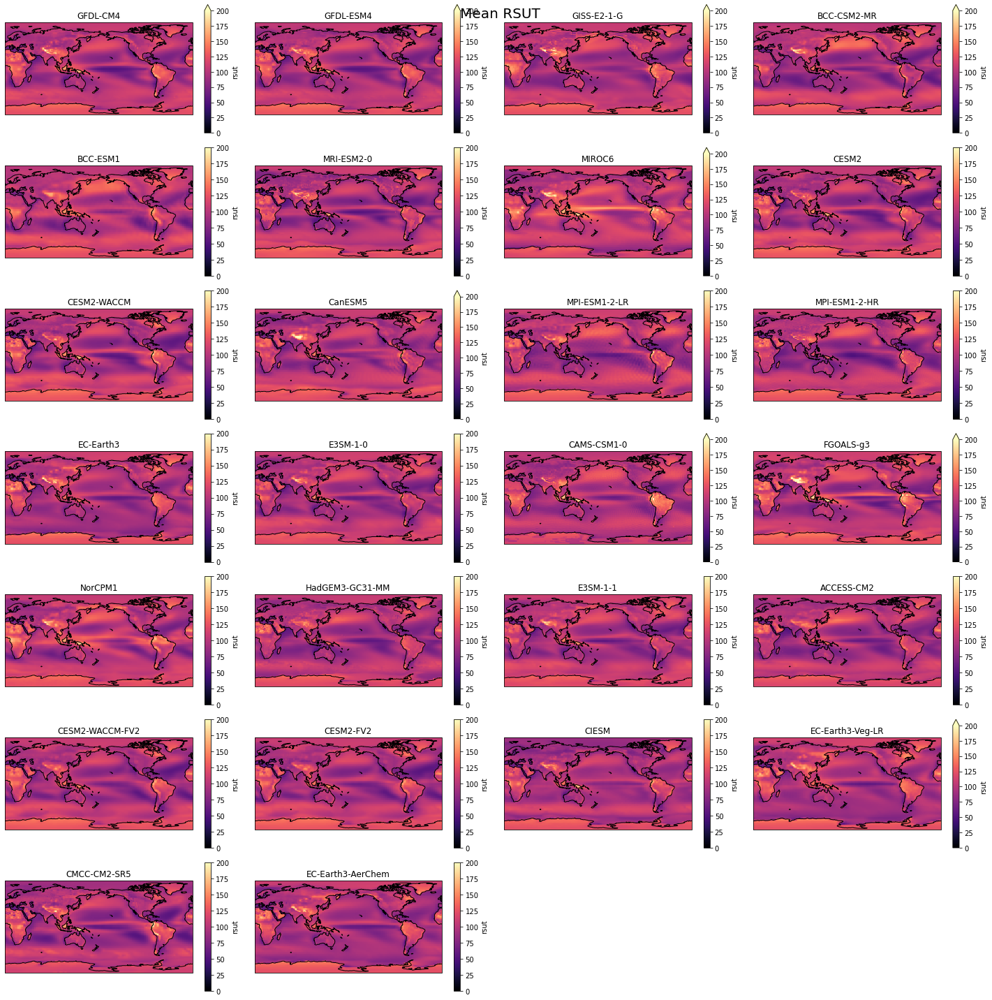

In [71]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in rsut_control['name'].values:
    ax = fig.add_subplot(7,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rsut_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=200, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean RSUT', fontsize=20, y=0.99)

In [23]:
rsut_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rsut_piControl_2x2_250yr.nc')

### rlut - upwards longwave top of atmosphere radiation

In [32]:
df_rlut_control = df.query("activity_id=='CMIP' & table_id == 'Amon' & variable_id == 'rlut' & experiment_id == 'piControl'")
df_rlut_control = df_rlut_control.drop_duplicates('source_id').head(42)
df_rlut_control = df_rlut_control.drop(index=[44325,206292,209037,217915,246411,253888,277099,287694,288715,294957,
                                             360733,375358,381254,384176,384232,385548])
df_rlut_control = df_rlut_control.drop(index=66848)
#df_rlut_control = df_rlut_control.drop(index=67721)
#df_rlut_control = df_rlut_control.drop(index=67750)
df_rlut_control = df_rlut_control.drop(index=76030)
df_rlut_control

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
9351,CMIP,NOAA-GFDL,GFDL-CM4,piControl,r1i1p1f1,Amon,rlut,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-CM4/piCon...,NaN,20180701
18479,CMIP,NOAA-GFDL,GFDL-ESM4,piControl,r1i1p1f1,Amon,rlut,gr1,gs://cmip6/CMIP6/CMIP/NOAA-GFDL/GFDL-ESM4/piCo...,NaN,20180701
31925,CMIP,CNRM-CERFACS,CNRM-CM6-1,piControl,r1i1p1f2,Amon,rlut,gr,gs://cmip6/CMIP6/CMIP/CNRM-CERFACS/CNRM-CM6-1/...,NaN,20180814
32225,CMIP,NASA-GISS,GISS-E2-1-G,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/NASA-GISS/GISS-E2-1-G/pi...,NaN,20180824
40401,CMIP,BCC,BCC-CSM2-MR,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-CSM2-MR/piContro...,NaN,20181016
42802,CMIP,CNRM-CERFACS,CNRM-ESM2-1,piControl,r1i1p1f2,Amon,rlut,gr,gs://cmip6/CMIP6/CMIP/CNRM-CERFACS/CNRM-ESM2-1...,NaN,20181115
44835,CMIP,BCC,BCC-ESM1,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/BCC/BCC-ESM1/piControl/r...,NaN,20181214
55745,CMIP,MRI,MRI-ESM2-0,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/MRI/MRI-ESM2-0/piControl...,NaN,20190222
67721,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2/piControl/r1i...,NaN,20190320
67750,CMIP,NCAR,CESM2-WACCM,piControl,r1i1p1f1,Amon,rlut,gn,gs://cmip6/CMIP6/CMIP/NCAR/CESM2-WACCM/piContr...,NaN,20190320


In [33]:
#this only needs to be created once
# From Ryan Abernathy's tutorial - Way 2
gcs = gcsfs.GCSFileSystem(token='anon')
fs = gcsfs.GCSFileSystem(token='anon', access='read_only')

# Regridding
new_lats=np.arange(-87,88,2)
new_lons=np.arange(1,359,2)

#time index to assign model times to
new_time_index=pd.date_range(start='1851-01-01',freq='M',periods=3000) #250 years
new_time_index
    
dset_list_rlut = []
for zstore in df_rlut_control.zstore.unique():
    # make a nice concise name from the zstore value
    name = zstore.split('gs://cmip6/CMIP6/')[1].replace('/','.')[:-1]
    name = zstore.split('gs://cmip6/CMIP6/CMIP/')[1].replace('/','.')[:-1]
    name_list = name.split('.')
    name = name_list[1]
    print(name)
    ds = xr.open_zarr(fs.get_mapper(zstore),consolidated=True)
    ds_sel = ds.isel(time=slice(0,3000))
    ds_rlut_interp = ds_sel.assign(time=new_time_index).interp(lat=new_lats,lon=new_lons)
    ds_rlut = ds_rlut_interp.rlut
    ds_rlut['name'] = name # Creating a new dimension for each ensemble member
    dset_list_rlut.append(ds_rlut)

GFDL-CM4
GFDL-ESM4
CNRM-CM6-1


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


GISS-E2-1-G
BCC-CSM2-MR
CNRM-ESM2-1
BCC-ESM1
MRI-ESM2-0
CESM2
CESM2-WACCM
CanESM5-CanOE
CanESM5
MPI-ESM1-2-LR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

MPI-ESM1-2-HR


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

E3SM-1-0
CAMS-CSM1-0
FGOALS-g3
HadGEM3-GC31-MM
CNRM-CM6-1-HR
FGOALS-f3-L
ACCESS-CM2


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:150: SerializationWarning: Ambiguous reference date string: 950-01-01. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0950-01-01). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 ob

CESM2-WACCM-FV2
CESM2-FV2
MPI-ESM-1-2-HAM


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/coding/times.py:688: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dty

In [34]:
rlut_control = xr.concat(dset_list_rlut, dim='name', coords='minimal', compat='override')
rlut_control.load()

<xarray.DataArray 'rlut' (name: 24, time: 3000, lat: 88, lon: 179)>
array([[[[182.30121231, 181.9868866 , 181.67826462, ..., 183.5706459 ,
          183.25151443, 182.93349838],
         [184.92015915, 184.21829376, 183.7177124 , ..., 187.63034286,
          186.97193146, 186.31452484],
         [189.25838165, 188.48704224, 187.69116211, ..., 192.4360733 ,
          191.63789749, 190.8369133 ],
         ...,
         [165.82805786, 166.16210098, 166.47512054, ..., 163.53362503,
          164.0615387 , 164.59881668],
         [161.39819183, 161.66302872, 161.9151535 , ..., 159.98974762,
          160.35243225, 160.71237717],
         [155.3404213 , 155.46360245, 155.6012764 , ..., 154.84158478,
          154.96718979, 155.0922348 ]],

        [[165.09339905, 164.70855865, 164.32799149, ..., 166.64758911,
          166.25688553, 165.86753693],
         [166.94574203, 166.02095108, 165.28549194, ..., 170.20068817,
          169.39380646, 168.58803558],
         [171.61716309, 170.63102341, 169.62907028, ..., 175.90477829,
          174.84729004, 173.7899826 ],
...
         [177.92788658, 178.51420733, 179.17544849, ..., 177.143173  ,
          177.28793804, 177.35980209],
         [176.9409371 , 177.26360865, 177.52878795, ..., 176.49843525,
          176.60015787, 176.65152558],
         [176.3773697 , 176.41307136, 176.4765847 , ..., 176.269719  ,
          176.38596622, 176.4079963 ]],

        [[175.03661398, 174.81979297, 174.63987239, ..., 175.9969703 ,
          175.77436807, 175.48494324],
         [176.35870061, 176.17603551, 176.03279999, ..., 177.22463847,
          176.94507086, 176.72536386],
         [180.20123261, 179.85054944, 179.4579852 , ..., 182.50535429,
          181.85426184, 181.25708495],
         ...,
         [163.139486  , 163.2655827 , 163.43588751, ..., 161.97679626,
          162.3449266 , 162.76403973],
         [159.67812171, 159.88720556, 160.0371759 , ..., 159.14576795,
          159.32265117, 159.45670593],
         [158.3429314 , 158.37517062, 158.43488371, ..., 158.38996114,
          158.35317757, 158.39302139]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U15 'GFDL-CM4' 'GFDL-ESM4' ... 'MPI-ESM-1-2-HAM'
Attributes:
    cell_measures:  area: areacella
    cell_methods:   area: time: mean
    interp_method:  conserve_order2
    long_name:      TOA Outgoing Longwave Radiation
    original_name:  rlut
    standard_name:  toa_outgoing_longwave_flux
    units:          W m-2

In [13]:
rlut_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_rlut_piControl_2x2_250yr.nc')

## TOA Total Flux

In [35]:
toa_control = rsdt_control - rlut_control - rsut_control

In [36]:
toa_control

<xarray.DataArray (name: 24, time: 3000, lat: 88, lon: 179)>
array([[[[ -37.6881668 ,  -37.40667759,  -37.24116033, ...,
           -38.19777899,  -38.00940196,  -38.11891527],
         [ -38.05499039,  -37.78511658,  -37.63130949, ...,
           -39.24086155,  -38.91885929,  -38.65625923],
         [ -40.26950333,  -39.64847134,  -39.38790762, ...,
           -42.00493553,  -41.66407612,  -41.38952759],
         ...,
         [-151.63350008, -151.70073132, -151.86766942, ...,
          -150.25311206, -150.77804884, -151.17746277],
         [-149.60993489, -149.55228545, -149.50194282, ...,
          -150.00956299, -149.94918056, -149.78074409],
         [-151.36526873, -151.353731  , -151.44148802, ...,
          -151.28785138, -151.37064289, -151.30239461]],

        [[ -69.955826  ,  -69.7674814 ,  -69.55942981, ...,
           -71.10447872,  -70.76841569,  -70.51529114],
         [ -71.7642334 ,  -71.5126877 ,  -71.03754037, ...,
           -73.67994137,  -73.15660129,  -72.67796691],
         [ -78.03571698,  -77.22950163,  -76.49640497, ...,
           -80.16445713,  -79.66710493,  -79.13230334],
...
         [-179.07311393, -180.17851096, -181.14056947, ...,
          -177.63018324, -177.64289686, -177.73913642],
         [-178.61781133, -179.08625149, -179.65903558, ...,
          -177.54938787, -177.792792  , -177.99728317],
         [-178.46992925, -178.647111  , -178.85531616, ...,
          -178.02586466, -177.95959473, -178.12548014]],

        [[ -28.31415939,  -28.15891596,  -28.1337827 , ...,
           -29.59033534,  -29.29088465,  -29.05277227],
         [ -29.35590481,  -29.05196652,  -28.74378883, ...,
           -29.71645338,  -29.52408515,  -29.51713359],
         [ -29.25767415,  -29.01118427,  -28.71161185, ...,
           -29.40685755,  -29.45692062,  -29.60023456],
         ...,
         [-180.79917916, -181.3523841 , -181.67032369, ...,
          -178.30396974, -179.17853334, -179.76145706],
         [-180.06681137, -180.24324256, -180.44816674, ...,
          -179.9173489 , -179.93222385, -179.90452067],
         [-179.5527799 , -179.40693029, -179.32705053, ...,
          -180.02038727, -179.82522329, -179.73671316]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 2100-12-31
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357
  * name     (name) <U15 'HadGEM3-GC31-MM' 'GFDL-CM4' ... 'CESM2-FV2'

In [37]:
toa_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_toa_piControl_2x2_250yr_24yr.nc')

In [34]:
toa_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_toa_piControl_2x2_250yr.nc')

Text(0.5, 0.99, 'Mean TOA Flux')

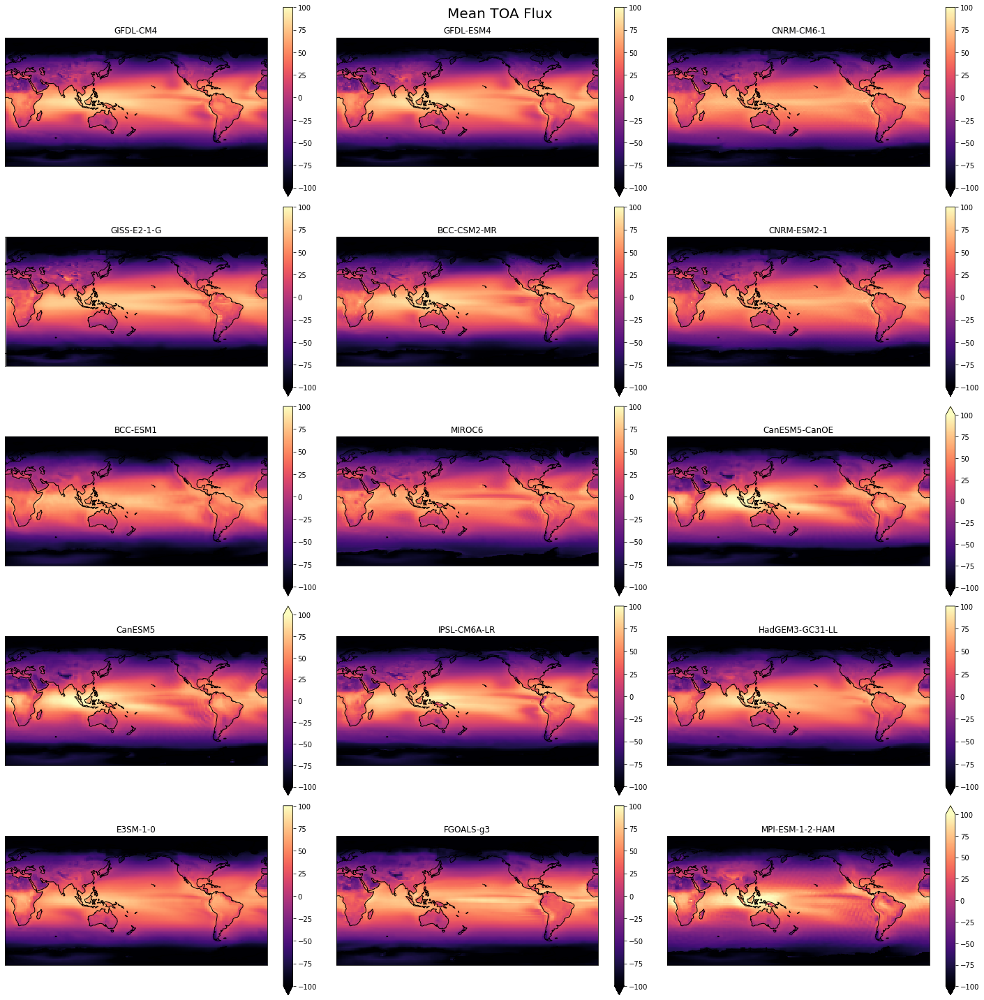

In [36]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in toa_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    toa_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='magma')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean TOA Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'TOA Flux Interdecadal Variability (>25 years)')

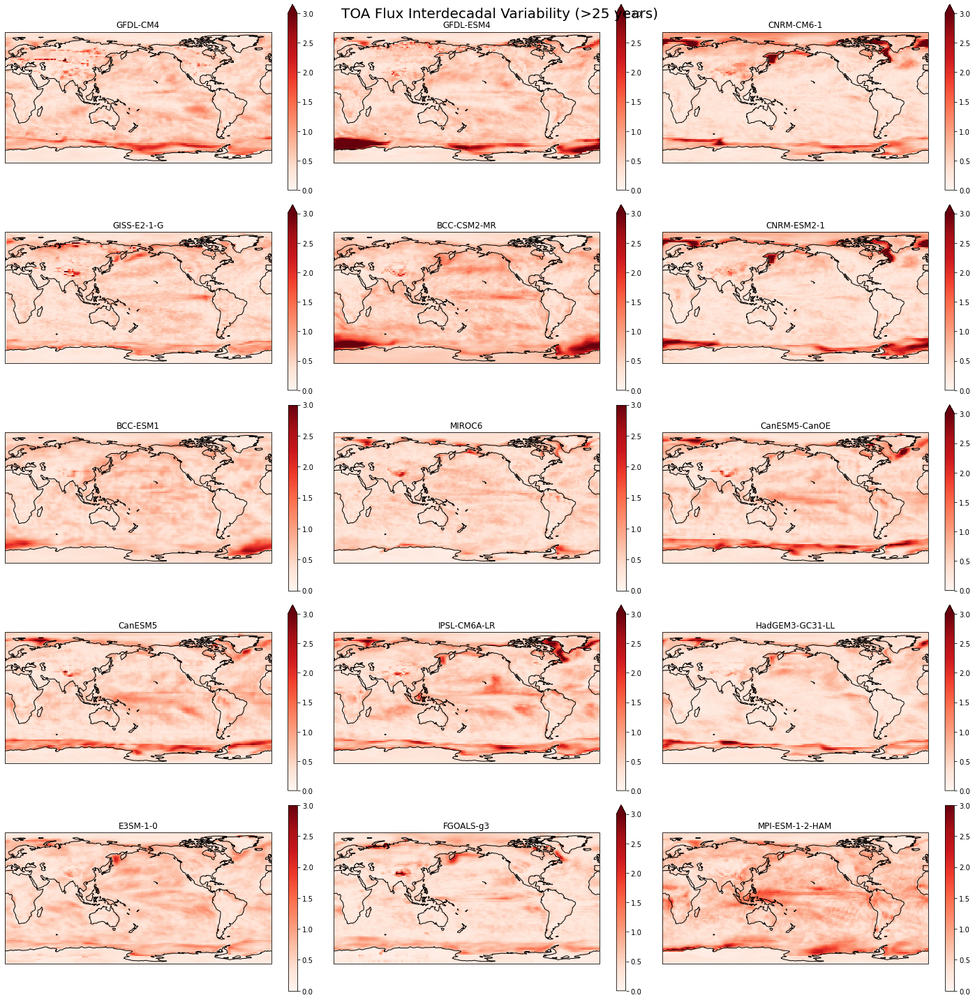

In [43]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in toa_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    rolling = toa_control.sel(name=model).rolling(time=300, center=True).mean('time')
    rolling.std('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=3, cmap='Reds')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('TOA Flux Interdecadal Variability (>25 years)', fontsize=20, y=0.99)

Text(0.5, 0.99, 'TOA Flux Interdecadal Variability (>25 years)')

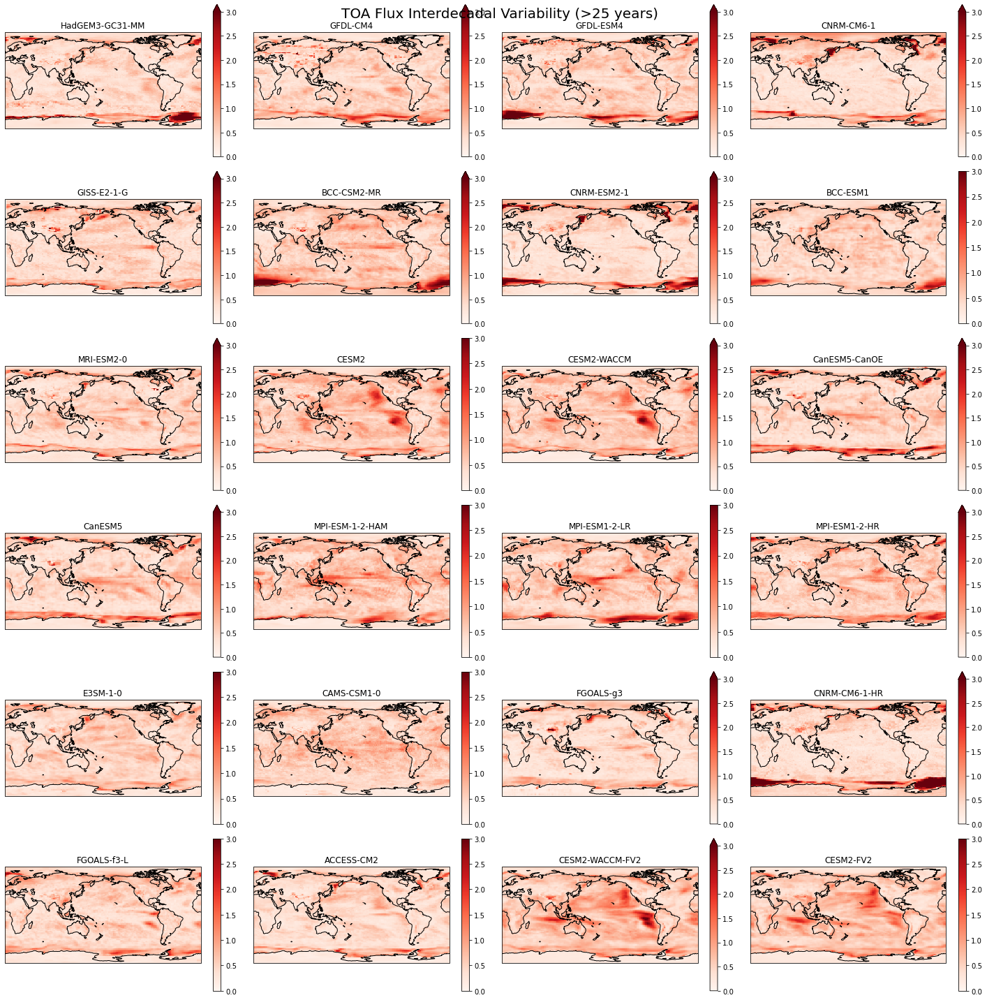

In [41]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in toa_control['name'].values:
    ax = fig.add_subplot(6,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rolling = toa_control.sel(name=model).rolling(time=300, center=True).mean('time')
    rolling.std('time').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=3, cmap='Reds')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('TOA Flux Interdecadal Variability (>25 years)', fontsize=20, y=0.99)

In [38]:
toa_rolling = toa_control.rolling(time=300, center=True).mean('time')
toa_stand = toa_rolling.std('time')
toa_var = toa_stand.mean('name')

Text(0.5, 1.0, '25 year TOA Flux interdecadal variability (N=15)')

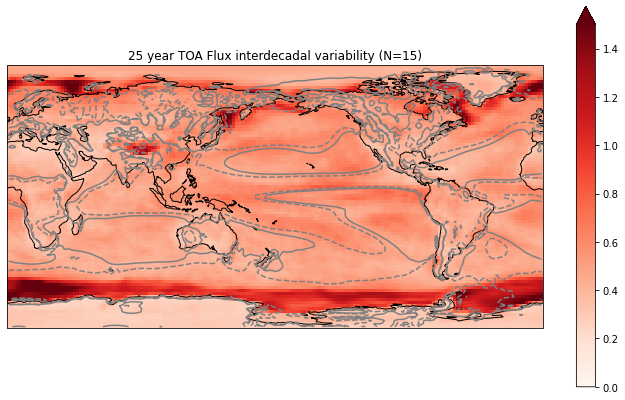

In [45]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
toa_var.plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=1.5, cmap='Reds')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('25 year TOA Flux interdecadal variability (N=15)')

## Horizontal Flux

In [39]:
horiz_control = surface_control - toa_control

In [42]:
horiz_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_horiz_piControl_2x2_250yr_24mod.nc')

In [58]:
horiz_control.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/250yeardatasets/CMIP_horiz_piControl_2x2_250yr.nc')

Text(0.5, 0.99, 'Mean Horiz Flux')

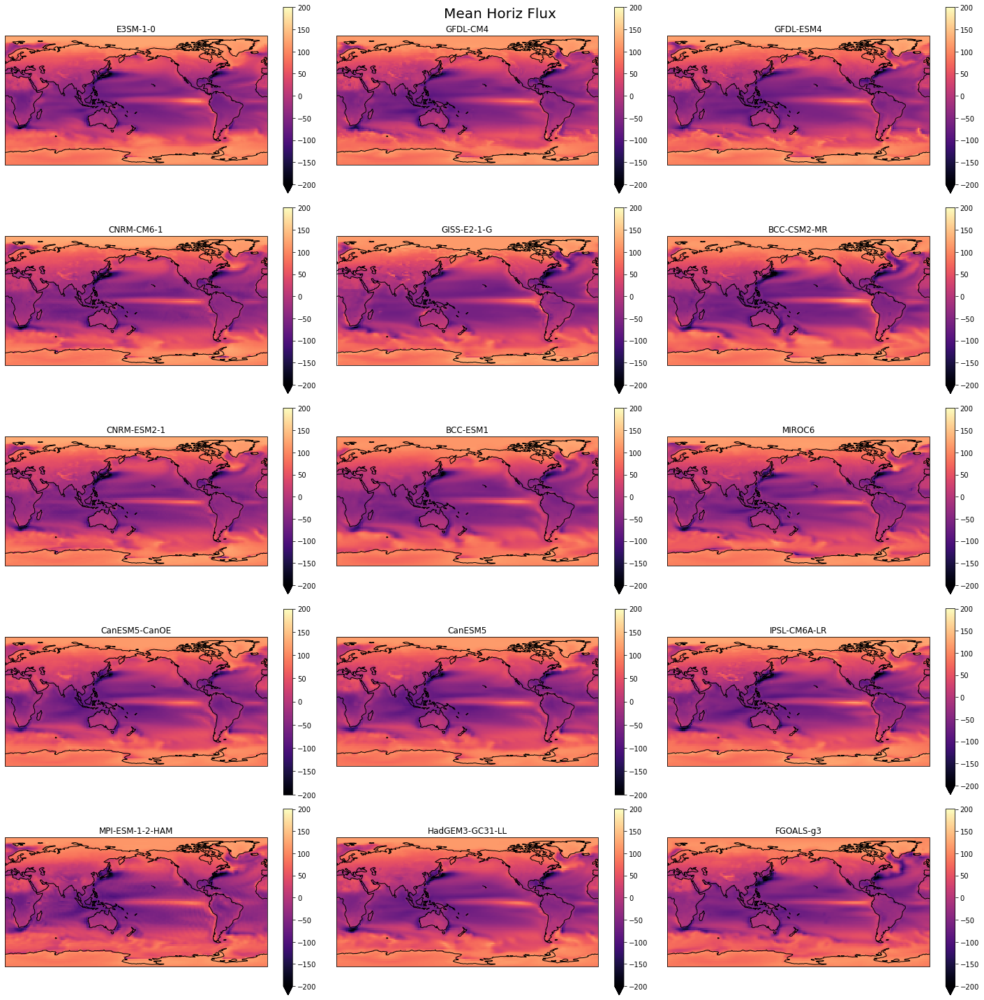

In [50]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in horiz_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    horiz_control.sel(name=model).mean('time').plot(ax=ax, transform=ccrs.PlateCarree(), cmap='magma', vmin=-200, vmax=200)
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Mean Horiz Flux', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Horiz. Flux Interdecadal Variability (>25 years)')

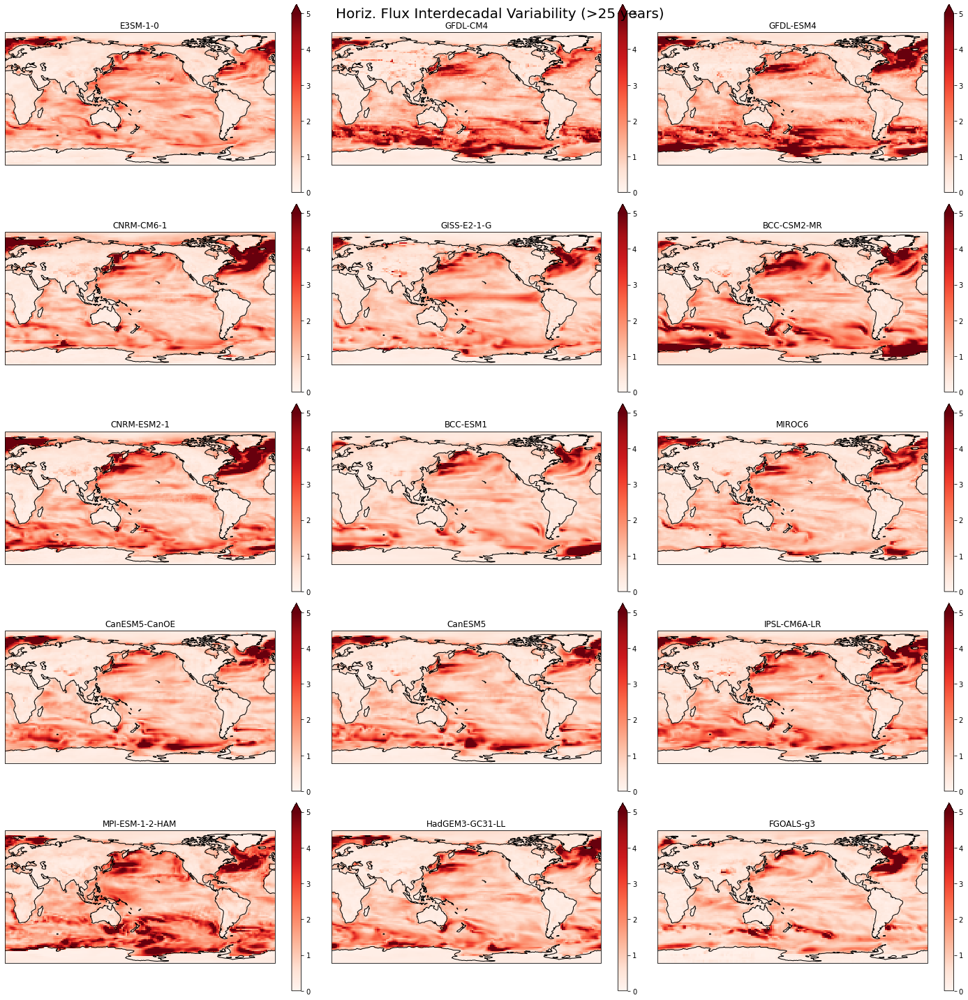

In [55]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in horiz_control['name'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    rolling = horiz_control.sel(name=model).rolling(time=300, center=True).mean('time')
    rolling.std('time').plot(ax=ax, transform=ccrs.PlateCarree(), cmap='Reds', vmin=0, vmax=5)
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Horiz. Flux Interdecadal Variability (>25 years)', fontsize=20, y=0.99)

Text(0.5, 0.99, 'Horiz. Flux Interdecadal Variability (>25 years)')

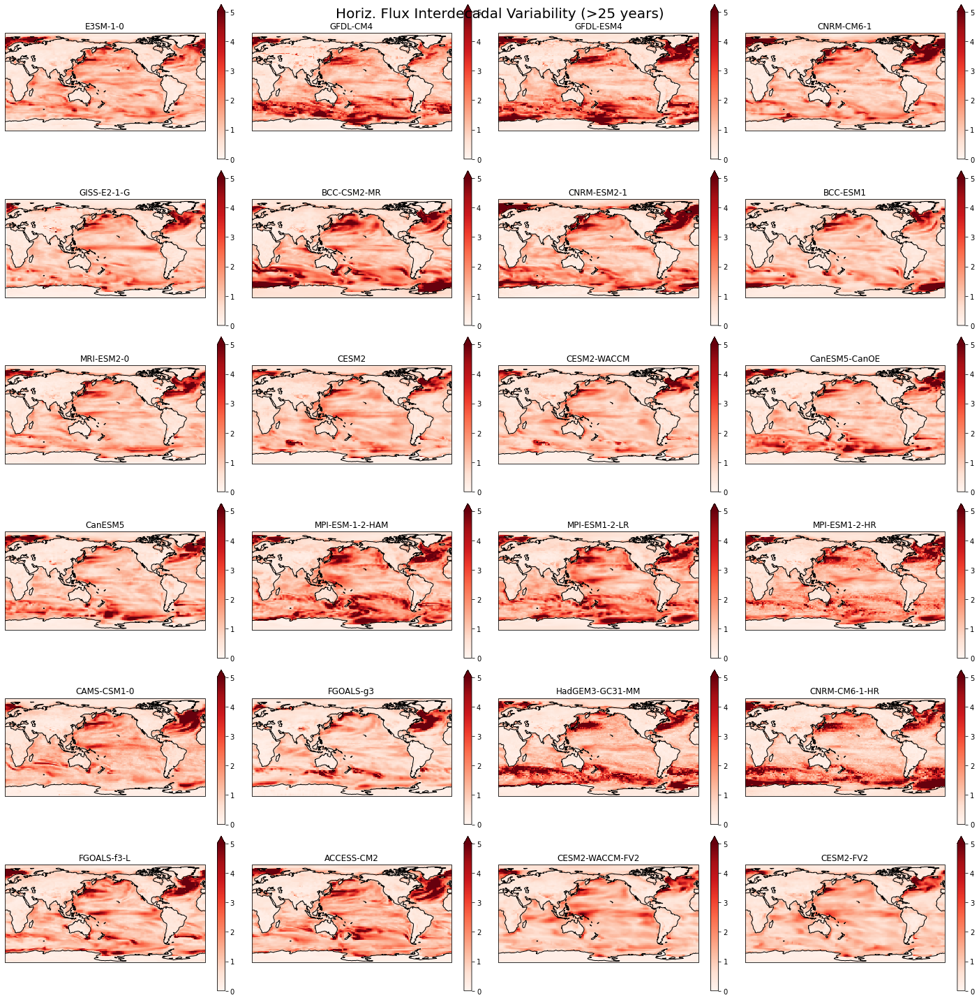

In [43]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in horiz_control['name'].values:
    ax = fig.add_subplot(6,4,i, projection=ccrs.PlateCarree(central_longitude=180))
    rolling = horiz_control.sel(name=model).rolling(time=300, center=True).mean('time')
    rolling.std('time').plot(ax=ax, transform=ccrs.PlateCarree(), cmap='Reds', vmin=0, vmax=5)
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('Horiz. Flux Interdecadal Variability (>25 years)', fontsize=20, y=0.99)

In [53]:
horiz_rolling = horiz_control.rolling(time=300, center=True).mean('time')
horiz_stand = horiz_rolling.std('time')
horiz_var = horiz_stand.mean('name')

Text(0.5, 1.0, '25 year Horiz. Flux interdecadal variability (N=15)')

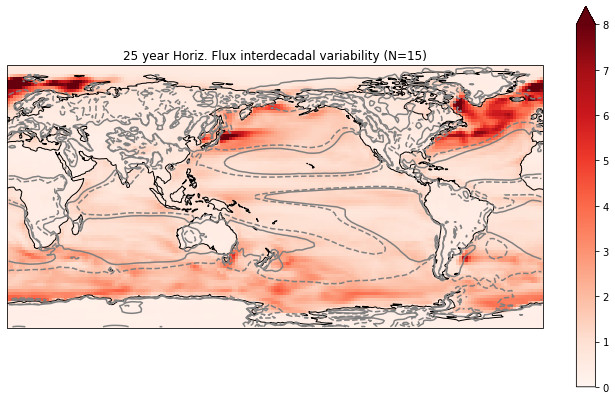

In [57]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
horiz_var.plot(ax=ax, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Reds')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('25 year Horiz. Flux interdecadal variability (N=15)')